<a href="https://colab.research.google.com/github/ashwindaswani/cartoon-GAN/blob/main/pokeGan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML


In [2]:
dataroot = "/content/drive/My Drive/GAN"
workers = 2
batch_size = 64
image_size = 64
nc = 3
nz = 100
ngf = 64
ndf = 64
num_epochs = 250
lr = 0.0002
beta1 = 0.5
ngpu = 1

In [3]:
manualSeed = random.randint(1, 10000)
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)


Random Seed:  6651


In [4]:
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

In [5]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

In [6]:
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

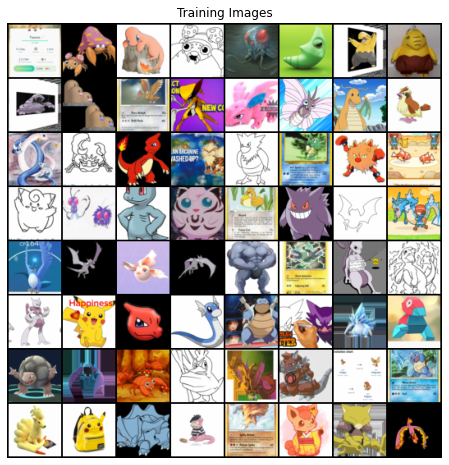

In [7]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [8]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [9]:

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [13]:
# Create the generator
generator = Generator(ngpu).to(device)
generator.apply(weights_init)
print(generator)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [11]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [12]:
discriminator = Discriminator(ngpu).to(device)
discriminator.apply(weights_init)
print(discriminator)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [15]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))

In [17]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
for epoch in range(num_epochs):
    # For each batch in the dataloader
    print("EPOCH================"+ str(epoch))
    for i, data in enumerate(dataloader, 0):

        discriminator.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = discriminator(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()
        

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = generator(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = discriminator(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        generator.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = discriminator(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            vutils.save_image(fake,fp='/content/drive/My Drive/GAN/'+str(iters)+'.jpg')
            torch.save(generator,'/content/drive/My Drive/GAN/generator-weights.h5')
            torch.save(discriminator, '/content/drive/My Drive/GAN/discriminator-weights.h5')
            

        iters += 1

Starting Training Loop...
EPOCH================0
[0/250][0/167]	Loss_D: 1.0606	Loss_G: 5.3037	D(x): 0.6224	D(G(z)): 0.3371 / 0.0066


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[0/250][50/167]	Loss_D: 0.0298	Loss_G: 30.9734	D(x): 0.9748	D(G(z)): 0.0000 / 0.0000


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[0/250][100/167]	Loss_D: 0.5519	Loss_G: 11.8834	D(x): 0.9140	D(G(z)): 0.2858 / 0.0000
[0/250][150/167]	Loss_D: 0.6315	Loss_G: 5.2803	D(x): 0.8696	D(G(z)): 0.2050 / 0.0151
EPOCH================1
[1/250][0/167]	Loss_D: 1.1394	Loss_G: 2.2357	D(x): 0.4439	D(G(z)): 0.0464 / 0.2508
[1/250][50/167]	Loss_D: 0.1015	Loss_G: 6.9960	D(x): 0.9438	D(G(z)): 0.0366 / 0.0017


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[1/250][100/167]	Loss_D: 0.5375	Loss_G: 6.0525	D(x): 0.6554	D(G(z)): 0.0027 / 0.0050
[1/250][150/167]	Loss_D: 0.0409	Loss_G: 7.0389	D(x): 0.9653	D(G(z)): 0.0042 / 0.0015
EPOCH================2
[2/250][0/167]	Loss_D: 0.5331	Loss_G: 7.4465	D(x): 0.7915	D(G(z)): 0.0079 / 0.0010


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[2/250][50/167]	Loss_D: 0.3729	Loss_G: 4.1138	D(x): 0.7720	D(G(z)): 0.0279 / 0.0277


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[2/250][100/167]	Loss_D: 0.6047	Loss_G: 8.5073	D(x): 0.9764	D(G(z)): 0.3587 / 0.0065
[2/250][150/167]	Loss_D: 0.6907	Loss_G: 4.1307	D(x): 0.9256	D(G(z)): 0.3873 / 0.0276
EPOCH================3
[3/250][0/167]	Loss_D: 0.7512	Loss_G: 1.4242	D(x): 0.6083	D(G(z)): 0.1094 / 0.2848


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[3/250][50/167]	Loss_D: 0.3374	Loss_G: 3.6773	D(x): 0.7824	D(G(z)): 0.0448 / 0.0656
[3/250][100/167]	Loss_D: 0.6251	Loss_G: 4.1072	D(x): 0.6310	D(G(z)): 0.0181 / 0.0260
[3/250][150/167]	Loss_D: 0.3930	Loss_G: 3.6271	D(x): 0.8177	D(G(z)): 0.1462 / 0.0363


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================4
[4/250][0/167]	Loss_D: 0.3483	Loss_G: 6.1950	D(x): 0.7901	D(G(z)): 0.0335 / 0.0059


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[4/250][50/167]	Loss_D: 0.6209	Loss_G: 3.3404	D(x): 0.6171	D(G(z)): 0.0280 / 0.0592
[4/250][100/167]	Loss_D: 0.3548	Loss_G: 3.5936	D(x): 0.7884	D(G(z)): 0.0694 / 0.0373
[4/250][150/167]	Loss_D: 0.1731	Loss_G: 5.0086	D(x): 0.8803	D(G(z)): 0.0275 / 0.0139
EPOCH================5
[5/250][0/167]	Loss_D: 1.9050	Loss_G: 2.1281	D(x): 0.3186	D(G(z)): 0.0285 / 0.2518
[5/250][50/167]	Loss_D: 1.1439	Loss_G: 0.5229	D(x): 0.4729	D(G(z)): 0.1179 / 0.6833


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[5/250][100/167]	Loss_D: 0.4545	Loss_G: 3.2674	D(x): 0.9264	D(G(z)): 0.2841 / 0.0511


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[5/250][150/167]	Loss_D: 0.2796	Loss_G: 4.8508	D(x): 0.9493	D(G(z)): 0.1850 / 0.0107
EPOCH================6
[6/250][0/167]	Loss_D: 0.7742	Loss_G: 8.9709	D(x): 0.9565	D(G(z)): 0.4302 / 0.0003
[6/250][50/167]	Loss_D: 0.9356	Loss_G: 3.0340	D(x): 0.6566	D(G(z)): 0.3136 / 0.0935


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[6/250][100/167]	Loss_D: 0.0309	Loss_G: 6.8048	D(x): 0.9807	D(G(z)): 0.0107 / 0.0028
[6/250][150/167]	Loss_D: 0.1139	Loss_G: 5.0213	D(x): 0.9541	D(G(z)): 0.0610 / 0.0101
EPOCH================7
[7/250][0/167]	Loss_D: 0.6772	Loss_G: 5.6754	D(x): 0.7650	D(G(z)): 0.2111 / 0.0132
[7/250][50/167]	Loss_D: 0.3826	Loss_G: 4.8756	D(x): 0.9315	D(G(z)): 0.2422 / 0.0104


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[7/250][100/167]	Loss_D: 0.1663	Loss_G: 3.6271	D(x): 0.9395	D(G(z)): 0.0878 / 0.0387


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[7/250][150/167]	Loss_D: 0.3085	Loss_G: 3.5712	D(x): 0.8522	D(G(z)): 0.1071 / 0.0392
EPOCH================8
[8/250][0/167]	Loss_D: 0.5027	Loss_G: 3.1109	D(x): 0.7928	D(G(z)): 0.1709 / 0.0602


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[8/250][50/167]	Loss_D: 0.3645	Loss_G: 3.0736	D(x): 0.8139	D(G(z)): 0.0809 / 0.0682


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[8/250][100/167]	Loss_D: 0.4962	Loss_G: 3.0426	D(x): 0.6951	D(G(z)): 0.0556 / 0.0694
[8/250][150/167]	Loss_D: 1.3180	Loss_G: 6.4864	D(x): 0.9523	D(G(z)): 0.6464 / 0.0034
EPOCH================9
[9/250][0/167]	Loss_D: 0.3020	Loss_G: 3.6797	D(x): 0.8742	D(G(z)): 0.1283 / 0.0408


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[9/250][50/167]	Loss_D: 0.8769	Loss_G: 2.9448	D(x): 0.5820	D(G(z)): 0.0934 / 0.0881
[9/250][100/167]	Loss_D: 0.3926	Loss_G: 4.1490	D(x): 0.7505	D(G(z)): 0.0288 / 0.0275
[9/250][150/167]	Loss_D: 0.6182	Loss_G: 6.9863	D(x): 0.9292	D(G(z)): 0.3625 / 0.0018
EPOCH================10
[10/250][0/167]	Loss_D: 0.7015	Loss_G: 5.4835	D(x): 0.8702	D(G(z)): 0.3418 / 0.0134
[10/250][50/167]	Loss_D: 0.3150	Loss_G: 4.2671	D(x): 0.9137	D(G(z)): 0.1871 / 0.0228


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[10/250][100/167]	Loss_D: 1.1429	Loss_G: 1.3135	D(x): 0.4781	D(G(z)): 0.0810 / 0.3630


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[10/250][150/167]	Loss_D: 0.2957	Loss_G: 3.1923	D(x): 0.8826	D(G(z)): 0.1368 / 0.0587
EPOCH================11
[11/250][0/167]	Loss_D: 0.7981	Loss_G: 1.0426	D(x): 0.5102	D(G(z)): 0.0194 / 0.4604
[11/250][50/167]	Loss_D: 0.6217	Loss_G: 2.9326	D(x): 0.6250	D(G(z)): 0.0583 / 0.1015


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[11/250][100/167]	Loss_D: 0.6654	Loss_G: 3.1445	D(x): 0.9300	D(G(z)): 0.3632 / 0.0794
[11/250][150/167]	Loss_D: 0.3169	Loss_G: 3.9884	D(x): 0.9008	D(G(z)): 0.1756 / 0.0260
EPOCH================12
[12/250][0/167]	Loss_D: 0.4088	Loss_G: 4.3298	D(x): 0.8794	D(G(z)): 0.1959 / 0.0225
[12/250][50/167]	Loss_D: 0.3139	Loss_G: 3.4611	D(x): 0.8826	D(G(z)): 0.1471 / 0.0442


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[12/250][100/167]	Loss_D: 0.3419	Loss_G: 3.9618	D(x): 0.9029	D(G(z)): 0.1904 / 0.0256
[12/250][150/167]	Loss_D: 1.2100	Loss_G: 7.8571	D(x): 0.9746	D(G(z)): 0.5921 / 0.0007
EPOCH================13
[13/250][0/167]	Loss_D: 0.4162	Loss_G: 5.0876	D(x): 0.9227	D(G(z)): 0.2502 / 0.0092


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[13/250][50/167]	Loss_D: 0.3726	Loss_G: 2.9213	D(x): 0.7953	D(G(z)): 0.0923 / 0.0882
[13/250][100/167]	Loss_D: 0.3114	Loss_G: 3.7702	D(x): 0.8131	D(G(z)): 0.0751 / 0.0432
[13/250][150/167]	Loss_D: 0.3146	Loss_G: 5.1149	D(x): 0.9296	D(G(z)): 0.1953 / 0.0089
EPOCH================14
[14/250][0/167]	Loss_D: 2.6924	Loss_G: 8.7871	D(x): 0.9961	D(G(z)): 0.8362 / 0.0004


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[14/250][50/167]	Loss_D: 0.3892	Loss_G: 3.8173	D(x): 0.8751	D(G(z)): 0.1819 / 0.0426


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[14/250][100/167]	Loss_D: 0.2915	Loss_G: 3.8411	D(x): 0.9159	D(G(z)): 0.1633 / 0.0273
[14/250][150/167]	Loss_D: 0.4736	Loss_G: 2.3554	D(x): 0.7855	D(G(z)): 0.1623 / 0.1346
EPOCH================15
[15/250][0/167]	Loss_D: 2.3764	Loss_G: 7.9710	D(x): 0.9946	D(G(z)): 0.8554 / 0.0009


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[15/250][50/167]	Loss_D: 0.3233	Loss_G: 3.4200	D(x): 0.8356	D(G(z)): 0.1120 / 0.0427
[15/250][100/167]	Loss_D: 0.5648	Loss_G: 3.2229	D(x): 0.7650	D(G(z)): 0.2026 / 0.0869


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[15/250][150/167]	Loss_D: 0.5245	Loss_G: 5.5148	D(x): 0.9501	D(G(z)): 0.3209 / 0.0078
EPOCH================16


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[16/250][0/167]	Loss_D: 0.5156	Loss_G: 3.3823	D(x): 0.6791	D(G(z)): 0.0185 / 0.0672
[16/250][50/167]	Loss_D: 0.3386	Loss_G: 5.1444	D(x): 0.9442	D(G(z)): 0.2198 / 0.0091
[16/250][100/167]	Loss_D: 0.2092	Loss_G: 4.9490	D(x): 0.9349	D(G(z)): 0.1142 / 0.0118
[16/250][150/167]	Loss_D: 0.2582	Loss_G: 3.3551	D(x): 0.8481	D(G(z)): 0.0630 / 0.0519
EPOCH================17
[17/250][0/167]	Loss_D: 1.1954	Loss_G: 8.2357	D(x): 0.9732	D(G(z)): 0.5669 / 0.0006
[17/250][50/167]	Loss_D: 0.3128	Loss_G: 3.6303	D(x): 0.8713	D(G(z)): 0.1446 / 0.0388


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[17/250][100/167]	Loss_D: 0.3296	Loss_G: 4.0075	D(x): 0.8499	D(G(z)): 0.1304 / 0.0329


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[17/250][150/167]	Loss_D: 0.1870	Loss_G: 3.9829	D(x): 0.9073	D(G(z)): 0.0760 / 0.0302
EPOCH================18
[18/250][0/167]	Loss_D: 0.1512	Loss_G: 4.9181	D(x): 0.8974	D(G(z)): 0.0361 / 0.0131


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[18/250][50/167]	Loss_D: 0.3177	Loss_G: 4.8972	D(x): 0.9325	D(G(z)): 0.1838 / 0.0124
[18/250][100/167]	Loss_D: 0.3673	Loss_G: 6.9675	D(x): 0.9506	D(G(z)): 0.2185 / 0.0016


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[18/250][150/167]	Loss_D: 0.3091	Loss_G: 3.7938	D(x): 0.8840	D(G(z)): 0.1407 / 0.0406
EPOCH================19
[19/250][0/167]	Loss_D: 0.2411	Loss_G: 3.5089	D(x): 0.9315	D(G(z)): 0.1350 / 0.0636


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[19/250][50/167]	Loss_D: 0.3315	Loss_G: 3.7109	D(x): 0.7708	D(G(z)): 0.0151 / 0.0419


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[19/250][100/167]	Loss_D: 0.3010	Loss_G: 2.8813	D(x): 0.8274	D(G(z)): 0.0772 / 0.0907
[19/250][150/167]	Loss_D: 1.3372	Loss_G: 1.0034	D(x): 0.3756	D(G(z)): 0.0051 / 0.4749
EPOCH================20
[20/250][0/167]	Loss_D: 0.2263	Loss_G: 4.0299	D(x): 0.9580	D(G(z)): 0.1415 / 0.0324


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[20/250][50/167]	Loss_D: 0.2672	Loss_G: 4.5152	D(x): 0.9565	D(G(z)): 0.1814 / 0.0149


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[20/250][100/167]	Loss_D: 0.3290	Loss_G: 4.3991	D(x): 0.8577	D(G(z)): 0.1202 / 0.0308
[20/250][150/167]	Loss_D: 0.5325	Loss_G: 5.9758	D(x): 0.6494	D(G(z)): 0.0031 / 0.0060
EPOCH================21
[21/250][0/167]	Loss_D: 0.1853	Loss_G: 4.0011	D(x): 0.9097	D(G(z)): 0.0747 / 0.0275


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[21/250][50/167]	Loss_D: 0.3073	Loss_G: 5.0939	D(x): 0.9596	D(G(z)): 0.2090 / 0.0090
[21/250][100/167]	Loss_D: 0.4977	Loss_G: 4.7771	D(x): 0.9006	D(G(z)): 0.2546 / 0.0165
[21/250][150/167]	Loss_D: 0.9269	Loss_G: 7.8738	D(x): 0.9903	D(G(z)): 0.5130 / 0.0009
EPOCH================22
[22/250][0/167]	Loss_D: 0.3812	Loss_G: 2.8101	D(x): 0.7774	D(G(z)): 0.0680 / 0.0961
[22/250][50/167]	Loss_D: 0.4727	Loss_G: 3.1231	D(x): 0.7309	D(G(z)): 0.0646 / 0.1292


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[22/250][100/167]	Loss_D: 0.1943	Loss_G: 5.3305	D(x): 0.9819	D(G(z)): 0.1469 / 0.0071
[22/250][150/167]	Loss_D: 0.4415	Loss_G: 2.5577	D(x): 0.7359	D(G(z)): 0.0552 / 0.1070


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================23
[23/250][0/167]	Loss_D: 0.2600	Loss_G: 3.3917	D(x): 0.8633	D(G(z)): 0.0923 / 0.0478


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[23/250][50/167]	Loss_D: 0.4077	Loss_G: 4.0417	D(x): 0.7666	D(G(z)): 0.0493 / 0.0427
[23/250][100/167]	Loss_D: 0.2979	Loss_G: 3.4708	D(x): 0.8170	D(G(z)): 0.0662 / 0.0465
[23/250][150/167]	Loss_D: 1.3022	Loss_G: 1.6788	D(x): 0.3423	D(G(z)): 0.0049 / 0.2874
EPOCH================24


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[24/250][0/167]	Loss_D: 0.2608	Loss_G: 3.9330	D(x): 0.9527	D(G(z)): 0.1739 / 0.0258
[24/250][50/167]	Loss_D: 0.1837	Loss_G: 3.0519	D(x): 0.8857	D(G(z)): 0.0445 / 0.0698
[24/250][100/167]	Loss_D: 0.2843	Loss_G: 3.5346	D(x): 0.8236	D(G(z)): 0.0612 / 0.0422


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[24/250][150/167]	Loss_D: 0.4521	Loss_G: 6.0422	D(x): 0.9357	D(G(z)): 0.2835 / 0.0039
EPOCH================25
[25/250][0/167]	Loss_D: 0.2645	Loss_G: 2.9740	D(x): 0.8116	D(G(z)): 0.0097 / 0.0854
[25/250][50/167]	Loss_D: 0.5388	Loss_G: 3.6567	D(x): 0.7846	D(G(z)): 0.2158 / 0.0380


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[25/250][100/167]	Loss_D: 0.2030	Loss_G: 4.8008	D(x): 0.9626	D(G(z)): 0.1376 / 0.0113
[25/250][150/167]	Loss_D: 0.2159	Loss_G: 4.1649	D(x): 0.9411	D(G(z)): 0.1329 / 0.0230
EPOCH================26
[26/250][0/167]	Loss_D: 0.2464	Loss_G: 2.7961	D(x): 0.8253	D(G(z)): 0.0355 / 0.0925


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[26/250][50/167]	Loss_D: 0.2290	Loss_G: 3.1437	D(x): 0.8641	D(G(z)): 0.0594 / 0.0594


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[26/250][100/167]	Loss_D: 0.1890	Loss_G: 5.1965	D(x): 0.9332	D(G(z)): 0.1028 / 0.0111
[26/250][150/167]	Loss_D: 0.1999	Loss_G: 3.6659	D(x): 0.9050	D(G(z)): 0.0776 / 0.0464
EPOCH================27
[27/250][0/167]	Loss_D: 0.1973	Loss_G: 4.3125	D(x): 0.8841	D(G(z)): 0.0446 / 0.0256


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[27/250][50/167]	Loss_D: 0.1409	Loss_G: 4.4088	D(x): 0.9286	D(G(z)): 0.0592 / 0.0199
[27/250][100/167]	Loss_D: 0.1233	Loss_G: 3.7774	D(x): 0.9280	D(G(z)): 0.0438 / 0.0358


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[27/250][150/167]	Loss_D: 0.3005	Loss_G: 5.7460	D(x): 0.7973	D(G(z)): 0.0341 / 0.0077
EPOCH================28
[28/250][0/167]	Loss_D: 0.2963	Loss_G: 3.1544	D(x): 0.8344	D(G(z)): 0.0723 / 0.0814


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[28/250][50/167]	Loss_D: 0.3462	Loss_G: 5.0206	D(x): 0.9595	D(G(z)): 0.2396 / 0.0103


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[28/250][100/167]	Loss_D: 0.5143	Loss_G: 1.4452	D(x): 0.6831	D(G(z)): 0.0216 / 0.3790
[28/250][150/167]	Loss_D: 0.2376	Loss_G: 3.6913	D(x): 0.8329	D(G(z)): 0.0407 / 0.0410
EPOCH================29
[29/250][0/167]	Loss_D: 0.2678	Loss_G: 4.6278	D(x): 0.7966	D(G(z)): 0.0116 / 0.0250


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[29/250][50/167]	Loss_D: 0.1234	Loss_G: 4.1211	D(x): 0.9555	D(G(z)): 0.0708 / 0.0261
[29/250][100/167]	Loss_D: 0.2249	Loss_G: 3.4305	D(x): 0.8771	D(G(z)): 0.0738 / 0.0542
[29/250][150/167]	Loss_D: 0.1776	Loss_G: 3.1228	D(x): 0.9639	D(G(z)): 0.1204 / 0.0644
EPOCH================30
[30/250][0/167]	Loss_D: 0.0977	Loss_G: 5.7093	D(x): 0.9243	D(G(z)): 0.0133 / 0.0077
[30/250][50/167]	Loss_D: 0.3321	Loss_G: 5.2219	D(x): 0.9761	D(G(z)): 0.2397 / 0.0100


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[30/250][100/167]	Loss_D: 0.2387	Loss_G: 3.7612	D(x): 0.9134	D(G(z)): 0.1208 / 0.0350


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[30/250][150/167]	Loss_D: 0.3890	Loss_G: 5.0924	D(x): 0.9741	D(G(z)): 0.2665 / 0.0111
EPOCH================31
[31/250][0/167]	Loss_D: 0.3228	Loss_G: 3.1755	D(x): 0.8554	D(G(z)): 0.1292 / 0.0604


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[31/250][50/167]	Loss_D: 0.2048	Loss_G: 3.6132	D(x): 0.8785	D(G(z)): 0.0615 / 0.0389
[31/250][100/167]	Loss_D: 0.2385	Loss_G: 4.5579	D(x): 0.9340	D(G(z)): 0.1302 / 0.0186


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[31/250][150/167]	Loss_D: 0.1704	Loss_G: 4.1474	D(x): 0.9526	D(G(z)): 0.1065 / 0.0248
EPOCH================32
[32/250][0/167]	Loss_D: 0.0946	Loss_G: 4.9706	D(x): 0.9415	D(G(z)): 0.0285 / 0.0143


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[32/250][50/167]	Loss_D: 0.1111	Loss_G: 5.1690	D(x): 0.9667	D(G(z)): 0.0688 / 0.0110


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[32/250][100/167]	Loss_D: 0.4299	Loss_G: 7.1380	D(x): 0.9527	D(G(z)): 0.2851 / 0.0013
[32/250][150/167]	Loss_D: 0.1392	Loss_G: 3.8299	D(x): 0.9405	D(G(z)): 0.0673 / 0.0337
EPOCH================33
[33/250][0/167]	Loss_D: 0.2944	Loss_G: 2.5803	D(x): 0.8311	D(G(z)): 0.0768 / 0.1251


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[33/250][50/167]	Loss_D: 0.1709	Loss_G: 4.3395	D(x): 0.9563	D(G(z)): 0.1045 / 0.0253
[33/250][100/167]	Loss_D: 0.1805	Loss_G: 3.9879	D(x): 0.9491	D(G(z)): 0.1118 / 0.0253
[33/250][150/167]	Loss_D: 0.3323	Loss_G: 5.4751	D(x): 0.9492	D(G(z)): 0.2127 / 0.0077
EPOCH================34
[34/250][0/167]	Loss_D: 0.1877	Loss_G: 4.5276	D(x): 0.9276	D(G(z)): 0.0950 / 0.0179


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[34/250][50/167]	Loss_D: 0.2215	Loss_G: 3.2858	D(x): 0.9110	D(G(z)): 0.1013 / 0.0569
[34/250][100/167]	Loss_D: 0.6413	Loss_G: 7.0357	D(x): 0.9606	D(G(z)): 0.3019 / 0.0061
[34/250][150/167]	Loss_D: 0.2518	Loss_G: 4.4322	D(x): 0.9433	D(G(z)): 0.1493 / 0.0228
EPOCH================35
[35/250][0/167]	Loss_D: 0.1757	Loss_G: 4.9872	D(x): 0.9392	D(G(z)): 0.0929 / 0.0129
[35/250][50/167]	Loss_D: 0.1749	Loss_G: 4.5034	D(x): 0.9647	D(G(z)): 0.1169 / 0.0174


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[35/250][100/167]	Loss_D: 0.1408	Loss_G: 4.8536	D(x): 0.9585	D(G(z)): 0.0771 / 0.0147
[35/250][150/167]	Loss_D: 0.1352	Loss_G: 4.8105	D(x): 0.9085	D(G(z)): 0.0334 / 0.0144
EPOCH================36


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[36/250][0/167]	Loss_D: 1.2026	Loss_G: 6.6735	D(x): 0.9718	D(G(z)): 0.5533 / 0.0030
[36/250][50/167]	Loss_D: 0.1660	Loss_G: 4.5575	D(x): 0.9332	D(G(z)): 0.0829 / 0.0176
[36/250][100/167]	Loss_D: 0.2370	Loss_G: 2.8827	D(x): 0.8619	D(G(z)): 0.0669 / 0.0808


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[36/250][150/167]	Loss_D: 0.2188	Loss_G: 4.4522	D(x): 0.8995	D(G(z)): 0.0835 / 0.0245
EPOCH================37
[37/250][0/167]	Loss_D: 0.3190	Loss_G: 4.9883	D(x): 0.9755	D(G(z)): 0.2196 / 0.0109
[37/250][50/167]	Loss_D: 0.1023	Loss_G: 5.2990	D(x): 0.9826	D(G(z)): 0.0731 / 0.0108


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[37/250][100/167]	Loss_D: 0.1186	Loss_G: 3.7152	D(x): 0.9440	D(G(z)): 0.0547 / 0.0410


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[37/250][150/167]	Loss_D: 0.1399	Loss_G: 5.9935	D(x): 0.9761	D(G(z)): 0.0993 / 0.0035
EPOCH================38
[38/250][0/167]	Loss_D: 0.1125	Loss_G: 4.0067	D(x): 0.9588	D(G(z)): 0.0640 / 0.0294
[38/250][50/167]	Loss_D: 1.6562	Loss_G: 2.5256	D(x): 0.3195	D(G(z)): 0.0054 / 0.1744


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[38/250][100/167]	Loss_D: 0.1819	Loss_G: 3.6683	D(x): 0.9385	D(G(z)): 0.1003 / 0.0457


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[38/250][150/167]	Loss_D: 0.1034	Loss_G: 4.3536	D(x): 0.9332	D(G(z)): 0.0301 / 0.0244
EPOCH================39
[39/250][0/167]	Loss_D: 0.4225	Loss_G: 2.9671	D(x): 0.7075	D(G(z)): 0.0129 / 0.0816


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[39/250][50/167]	Loss_D: 0.1255	Loss_G: 3.9336	D(x): 0.9622	D(G(z)): 0.0739 / 0.0337
[39/250][100/167]	Loss_D: 0.1254	Loss_G: 3.5436	D(x): 0.9759	D(G(z)): 0.0905 / 0.0396
[39/250][150/167]	Loss_D: 0.1374	Loss_G: 3.7450	D(x): 0.9110	D(G(z)): 0.0372 / 0.0429
EPOCH================40
[40/250][0/167]	Loss_D: 1.1637	Loss_G: 0.6212	D(x): 0.3927	D(G(z)): 0.0037 / 0.6491


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[40/250][50/167]	Loss_D: 0.1650	Loss_G: 3.3377	D(x): 0.9471	D(G(z)): 0.0965 / 0.0612
[40/250][100/167]	Loss_D: 0.3113	Loss_G: 3.4542	D(x): 0.8173	D(G(z)): 0.0769 / 0.0594
[40/250][150/167]	Loss_D: 0.3152	Loss_G: 2.0824	D(x): 0.7901	D(G(z)): 0.0339 / 0.2218
EPOCH================41
[41/250][0/167]	Loss_D: 0.1118	Loss_G: 4.3286	D(x): 0.9300	D(G(z)): 0.0343 / 0.0285
[41/250][50/167]	Loss_D: 0.2448	Loss_G: 2.9355	D(x): 0.8467	D(G(z)): 0.0504 / 0.0851


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[41/250][100/167]	Loss_D: 0.1644	Loss_G: 3.7524	D(x): 0.9208	D(G(z)): 0.0646 / 0.0425
[41/250][150/167]	Loss_D: 0.1018	Loss_G: 4.5490	D(x): 0.9742	D(G(z)): 0.0681 / 0.0165
EPOCH================42
[42/250][0/167]	Loss_D: 0.2385	Loss_G: 5.7248	D(x): 0.9676	D(G(z)): 0.1668 / 0.0046
[42/250][50/167]	Loss_D: 0.4412	Loss_G: 7.1633	D(x): 0.9958	D(G(z)): 0.3088 / 0.0019


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[42/250][100/167]	Loss_D: 0.1510	Loss_G: 4.1998	D(x): 0.9460	D(G(z)): 0.0833 / 0.0275


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[42/250][150/167]	Loss_D: 0.5506	Loss_G: 4.8417	D(x): 0.6789	D(G(z)): 0.0033 / 0.0313
EPOCH================43
[43/250][0/167]	Loss_D: 0.7823	Loss_G: 1.8997	D(x): 0.7162	D(G(z)): 0.2049 / 0.2344


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[43/250][50/167]	Loss_D: 0.2057	Loss_G: 6.3994	D(x): 0.8565	D(G(z)): 0.0175 / 0.0051


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[43/250][100/167]	Loss_D: 1.0524	Loss_G: 7.9581	D(x): 0.9959	D(G(z)): 0.5518 / 0.0010
[43/250][150/167]	Loss_D: 0.1473	Loss_G: 4.0807	D(x): 0.9246	D(G(z)): 0.0598 / 0.0302
EPOCH================44
[44/250][0/167]	Loss_D: 0.3549	Loss_G: 4.2411	D(x): 0.7531	D(G(z)): 0.0143 / 0.0342
[44/250][50/167]	Loss_D: 0.1260	Loss_G: 4.4408	D(x): 0.9660	D(G(z)): 0.0724 / 0.0202


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[44/250][100/167]	Loss_D: 0.4122	Loss_G: 2.4942	D(x): 0.7654	D(G(z)): 0.0667 / 0.1718


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[44/250][150/167]	Loss_D: 0.1644	Loss_G: 3.5062	D(x): 0.9275	D(G(z)): 0.0782 / 0.0474
EPOCH================45
[45/250][0/167]	Loss_D: 0.3688	Loss_G: 5.6058	D(x): 0.9958	D(G(z)): 0.2567 / 0.0055
[45/250][50/167]	Loss_D: 0.2026	Loss_G: 3.2620	D(x): 0.8605	D(G(z)): 0.0348 / 0.0652


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[45/250][100/167]	Loss_D: 0.1892	Loss_G: 5.0634	D(x): 0.9848	D(G(z)): 0.1443 / 0.0104
[45/250][150/167]	Loss_D: 0.1975	Loss_G: 3.4416	D(x): 0.8674	D(G(z)): 0.0419 / 0.0527
EPOCH================46
[46/250][0/167]	Loss_D: 0.1885	Loss_G: 5.4273	D(x): 0.8521	D(G(z)): 0.0096 / 0.0141


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[46/250][50/167]	Loss_D: 0.2970	Loss_G: 1.4247	D(x): 0.7968	D(G(z)): 0.0375 / 0.3216
[46/250][100/167]	Loss_D: 0.1190	Loss_G: 4.6752	D(x): 0.9452	D(G(z)): 0.0554 / 0.0181
[46/250][150/167]	Loss_D: 0.2598	Loss_G: 4.3084	D(x): 0.9663	D(G(z)): 0.1792 / 0.0248
EPOCH================47
[47/250][0/167]	Loss_D: 0.2525	Loss_G: 4.5840	D(x): 0.9477	D(G(z)): 0.1460 / 0.0172


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[47/250][50/167]	Loss_D: 0.0909	Loss_G: 4.6688	D(x): 0.9499	D(G(z)): 0.0344 / 0.0175
[47/250][100/167]	Loss_D: 0.0856	Loss_G: 3.7707	D(x): 0.9393	D(G(z)): 0.0198 / 0.0373


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[47/250][150/167]	Loss_D: 0.5721	Loss_G: 3.6127	D(x): 0.7063	D(G(z)): 0.1010 / 0.0669
EPOCH================48
[48/250][0/167]	Loss_D: 0.5078	Loss_G: 1.7180	D(x): 0.7339	D(G(z)): 0.1151 / 0.2501


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[48/250][50/167]	Loss_D: 0.0959	Loss_G: 4.7804	D(x): 0.9340	D(G(z)): 0.0246 / 0.0159
[48/250][100/167]	Loss_D: 0.2562	Loss_G: 3.1652	D(x): 0.8096	D(G(z)): 0.0189 / 0.0902
[48/250][150/167]	Loss_D: 0.4575	Loss_G: 2.2591	D(x): 0.6974	D(G(z)): 0.0146 / 0.1992


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================49
[49/250][0/167]	Loss_D: 0.1697	Loss_G: 4.1331	D(x): 0.9458	D(G(z)): 0.0976 / 0.0251


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[49/250][50/167]	Loss_D: 0.1863	Loss_G: 4.4441	D(x): 0.9634	D(G(z)): 0.1159 / 0.0198
[49/250][100/167]	Loss_D: 0.0637	Loss_G: 5.3965	D(x): 0.9564	D(G(z)): 0.0171 / 0.0092
[49/250][150/167]	Loss_D: 0.1192	Loss_G: 5.3424	D(x): 0.8984	D(G(z)): 0.0069 / 0.0120
EPOCH================50
[50/250][0/167]	Loss_D: 0.1845	Loss_G: 4.3173	D(x): 0.9745	D(G(z)): 0.1334 / 0.0205


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[50/250][50/167]	Loss_D: 0.0732	Loss_G: 5.1209	D(x): 0.9752	D(G(z)): 0.0433 / 0.0104
[50/250][100/167]	Loss_D: 0.1031	Loss_G: 4.6082	D(x): 0.9686	D(G(z)): 0.0616 / 0.0186


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[50/250][150/167]	Loss_D: 9.7119	Loss_G: 4.1990	D(x): 0.6839	D(G(z)): 0.6635 / 0.1755
EPOCH================51


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[51/250][0/167]	Loss_D: 1.8091	Loss_G: 2.1324	D(x): 0.6421	D(G(z)): 0.4065 / 0.2669
[51/250][50/167]	Loss_D: 0.5700	Loss_G: 1.9204	D(x): 0.6644	D(G(z)): 0.0373 / 0.2167


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[51/250][100/167]	Loss_D: 0.1499	Loss_G: 5.3627	D(x): 0.8949	D(G(z)): 0.0232 / 0.0124
[51/250][150/167]	Loss_D: 0.1634	Loss_G: 4.0725	D(x): 0.9366	D(G(z)): 0.0851 / 0.0293
EPOCH================52
[52/250][0/167]	Loss_D: 0.1240	Loss_G: 4.8191	D(x): 0.9640	D(G(z)): 0.0793 / 0.0134


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[52/250][50/167]	Loss_D: 0.1088	Loss_G: 4.9154	D(x): 0.9548	D(G(z)): 0.0520 / 0.0127
[52/250][100/167]	Loss_D: 0.0858	Loss_G: 3.9840	D(x): 0.9714	D(G(z)): 0.0517 / 0.0304
[52/250][150/167]	Loss_D: 0.1409	Loss_G: 3.6980	D(x): 0.9169	D(G(z)): 0.0460 / 0.0401
EPOCH================53
[53/250][0/167]	Loss_D: 0.0945	Loss_G: 4.4353	D(x): 0.9302	D(G(z)): 0.0168 / 0.0216
[53/250][50/167]	Loss_D: 0.5311	Loss_G: 3.7469	D(x): 0.8955	D(G(z)): 0.2717 / 0.0411


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[53/250][100/167]	Loss_D: 0.4921	Loss_G: 1.9266	D(x): 0.6979	D(G(z)): 0.0339 / 0.2567
[53/250][150/167]	Loss_D: 0.1745	Loss_G: 3.6528	D(x): 0.9611	D(G(z)): 0.1087 / 0.0456
EPOCH================54
[54/250][0/167]	Loss_D: 0.1510	Loss_G: 5.0387	D(x): 0.9762	D(G(z)): 0.1050 / 0.0126


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[54/250][50/167]	Loss_D: 0.1323	Loss_G: 4.6585	D(x): 0.9515	D(G(z)): 0.0701 / 0.0180
[54/250][100/167]	Loss_D: 0.0880	Loss_G: 3.4863	D(x): 0.9545	D(G(z)): 0.0388 / 0.0463
[54/250][150/167]	Loss_D: 0.0950	Loss_G: 4.4621	D(x): 0.9721	D(G(z)): 0.0600 / 0.0202
EPOCH================55
[55/250][0/167]	Loss_D: 0.2086	Loss_G: 5.3746	D(x): 0.9538	D(G(z)): 0.1319 / 0.0068


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[55/250][50/167]	Loss_D: 0.1289	Loss_G: 3.7156	D(x): 0.9189	D(G(z)): 0.0384 / 0.0429
[55/250][100/167]	Loss_D: 1.5702	Loss_G: 2.9224	D(x): 0.5678	D(G(z)): 0.3002 / 0.2413
[55/250][150/167]	Loss_D: 1.0273	Loss_G: 6.6386	D(x): 0.9708	D(G(z)): 0.5313 / 0.0033
EPOCH================56
[56/250][0/167]	Loss_D: 0.9491	Loss_G: 6.0729	D(x): 0.9830	D(G(z)): 0.4946 / 0.0051
[56/250][50/167]	Loss_D: 0.4019	Loss_G: 5.0754	D(x): 0.7204	D(G(z)): 0.0070 / 0.0119
[56/250][100/167]	Loss_D: 0.2106	Loss_G: 4.2977	D(x): 0.9752	D(G(z)): 0.1484 / 0.0250


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[56/250][150/167]	Loss_D: 0.1918	Loss_G: 5.2193	D(x): 0.9622	D(G(z)): 0.1230 / 0.0100
EPOCH================57
[57/250][0/167]	Loss_D: 0.1342	Loss_G: 3.8525	D(x): 0.9144	D(G(z)): 0.0376 / 0.0361


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[57/250][50/167]	Loss_D: 0.1157	Loss_G: 3.9562	D(x): 0.9106	D(G(z)): 0.0172 / 0.0353


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[57/250][100/167]	Loss_D: 0.1306	Loss_G: 4.7881	D(x): 0.9037	D(G(z)): 0.0190 / 0.0178
[57/250][150/167]	Loss_D: 0.1557	Loss_G: 4.4952	D(x): 0.9870	D(G(z)): 0.1213 / 0.0182
EPOCH================58
[58/250][0/167]	Loss_D: 0.1802	Loss_G: 5.9053	D(x): 0.8523	D(G(z)): 0.0054 / 0.0080
[58/250][50/167]	Loss_D: 0.2101	Loss_G: 3.0410	D(x): 0.8428	D(G(z)): 0.0245 / 0.0868


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[58/250][100/167]	Loss_D: 0.2255	Loss_G: 5.3181	D(x): 0.9148	D(G(z)): 0.1015 / 0.0107


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[58/250][150/167]	Loss_D: 0.2959	Loss_G: 3.5987	D(x): 0.7992	D(G(z)): 0.0288 / 0.0456
EPOCH================59
[59/250][0/167]	Loss_D: 0.1556	Loss_G: 3.7943	D(x): 0.9712	D(G(z)): 0.1093 / 0.0367
[59/250][50/167]	Loss_D: 0.0315	Loss_G: 6.2204	D(x): 0.9811	D(G(z)): 0.0119 / 0.0053


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[59/250][100/167]	Loss_D: 0.1668	Loss_G: 3.7743	D(x): 0.9270	D(G(z)): 0.0739 / 0.0375


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[59/250][150/167]	Loss_D: 0.1949	Loss_G: 2.4925	D(x): 0.9188	D(G(z)): 0.0885 / 0.1260
EPOCH================60
[60/250][0/167]	Loss_D: 0.1073	Loss_G: 4.0103	D(x): 0.9671	D(G(z)): 0.0683 / 0.0262


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[60/250][50/167]	Loss_D: 0.2711	Loss_G: 5.0120	D(x): 0.9322	D(G(z)): 0.1489 / 0.0128
[60/250][100/167]	Loss_D: 0.2849	Loss_G: 3.6809	D(x): 0.8745	D(G(z)): 0.1111 / 0.0432


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[60/250][150/167]	Loss_D: 0.2204	Loss_G: 4.4182	D(x): 0.9909	D(G(z)): 0.1650 / 0.0185
EPOCH================61
[61/250][0/167]	Loss_D: 0.1004	Loss_G: 4.3583	D(x): 0.9726	D(G(z)): 0.0652 / 0.0229
[61/250][50/167]	Loss_D: 0.0603	Loss_G: 5.1785	D(x): 0.9745	D(G(z)): 0.0319 / 0.0106


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[61/250][100/167]	Loss_D: 0.0879	Loss_G: 3.8060	D(x): 0.9331	D(G(z)): 0.0133 / 0.0524
[61/250][150/167]	Loss_D: 0.1046	Loss_G: 3.8940	D(x): 0.9247	D(G(z)): 0.0226 / 0.0340


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================62
[62/250][0/167]	Loss_D: 0.0646	Loss_G: 4.7788	D(x): 0.9599	D(G(z)): 0.0220 / 0.0168


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[62/250][50/167]	Loss_D: 0.0678	Loss_G: 5.0887	D(x): 0.9679	D(G(z)): 0.0330 / 0.0110


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[62/250][100/167]	Loss_D: 0.0594	Loss_G: 4.7605	D(x): 0.9556	D(G(z)): 0.0121 / 0.0172
[62/250][150/167]	Loss_D: 0.2721	Loss_G: 4.2608	D(x): 0.9453	D(G(z)): 0.1664 / 0.0265
EPOCH================63
[63/250][0/167]	Loss_D: 0.2258	Loss_G: 4.7085	D(x): 0.9167	D(G(z)): 0.1067 / 0.0205
[63/250][50/167]	Loss_D: 0.1371	Loss_G: 4.8787	D(x): 0.9852	D(G(z)): 0.0942 / 0.0144


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[63/250][100/167]	Loss_D: 0.1091	Loss_G: 3.8198	D(x): 0.9495	D(G(z)): 0.0510 / 0.0388
[63/250][150/167]	Loss_D: 0.0755	Loss_G: 4.2835	D(x): 0.9731	D(G(z)): 0.0450 / 0.0224
EPOCH================64
[64/250][0/167]	Loss_D: 0.1253	Loss_G: 3.8831	D(x): 0.9013	D(G(z)): 0.0150 / 0.0477
[64/250][50/167]	Loss_D: 0.3147	Loss_G: 3.3354	D(x): 0.7964	D(G(z)): 0.0300 / 0.0926


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[64/250][100/167]	Loss_D: 0.1370	Loss_G: 3.5158	D(x): 0.9262	D(G(z)): 0.0526 / 0.0427
[64/250][150/167]	Loss_D: 0.0979	Loss_G: 3.8848	D(x): 0.9216	D(G(z)): 0.0129 / 0.0408
EPOCH================65
[65/250][0/167]	Loss_D: 0.9381	Loss_G: 1.6545	D(x): 0.6130	D(G(z)): 0.0361 / 0.3134


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[65/250][50/167]	Loss_D: 0.1572	Loss_G: 5.1054	D(x): 0.9881	D(G(z)): 0.1185 / 0.0105
[65/250][100/167]	Loss_D: 0.2271	Loss_G: 2.8899	D(x): 0.8374	D(G(z)): 0.0304 / 0.0878
[65/250][150/167]	Loss_D: 0.1651	Loss_G: 3.7137	D(x): 0.8763	D(G(z)): 0.0217 / 0.0486
EPOCH================66
[66/250][0/167]	Loss_D: 0.2352	Loss_G: 2.1791	D(x): 0.8350	D(G(z)): 0.0230 / 0.1899


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[66/250][50/167]	Loss_D: 0.0779	Loss_G: 4.8922	D(x): 0.9415	D(G(z)): 0.0144 / 0.0135
[66/250][100/167]	Loss_D: 0.0513	Loss_G: 4.9750	D(x): 0.9676	D(G(z)): 0.0167 / 0.0156
[66/250][150/167]	Loss_D: 0.1674	Loss_G: 2.8047	D(x): 0.8623	D(G(z)): 0.0103 / 0.1311
EPOCH================67
[67/250][0/167]	Loss_D: 0.0441	Loss_G: 5.6763	D(x): 0.9782	D(G(z)): 0.0210 / 0.0080
[67/250][50/167]	Loss_D: 3.9350	Loss_G: 3.9826	D(x): 0.4932	D(G(z)): 0.4161 / 0.3558
[67/250][100/167]	Loss_D: 0.1692	Loss_G: 5.0557	D(x): 0.9569	D(G(z)): 0.0962 / 0.0146


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[67/250][150/167]	Loss_D: 0.0894	Loss_G: 4.7491	D(x): 0.9923	D(G(z)): 0.0746 / 0.0137
EPOCH================68
[68/250][0/167]	Loss_D: 0.1051	Loss_G: 4.2798	D(x): 0.9587	D(G(z)): 0.0579 / 0.0223


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[68/250][50/167]	Loss_D: 0.0744	Loss_G: 4.9647	D(x): 0.9501	D(G(z)): 0.0207 / 0.0141


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[68/250][100/167]	Loss_D: 0.0499	Loss_G: 5.5990	D(x): 0.9645	D(G(z)): 0.0121 / 0.0084
[68/250][150/167]	Loss_D: 4.2083	Loss_G: 0.0304	D(x): 0.0350	D(G(z)): 0.0007 / 0.9711
EPOCH================69
[69/250][0/167]	Loss_D: 0.4536	Loss_G: 3.5471	D(x): 0.9071	D(G(z)): 0.2072 / 0.0616


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[69/250][50/167]	Loss_D: 0.1019	Loss_G: 3.4822	D(x): 0.9701	D(G(z)): 0.0634 / 0.0557
[69/250][100/167]	Loss_D: 0.3148	Loss_G: 5.9666	D(x): 0.9858	D(G(z)): 0.2247 / 0.0042
[69/250][150/167]	Loss_D: 0.0714	Loss_G: 4.7018	D(x): 0.9553	D(G(z)): 0.0232 / 0.0178
EPOCH================70
[70/250][0/167]	Loss_D: 0.0693	Loss_G: 4.7537	D(x): 0.9847	D(G(z)): 0.0487 / 0.0156


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[70/250][50/167]	Loss_D: 0.1476	Loss_G: 3.6460	D(x): 0.9018	D(G(z)): 0.0340 / 0.0427
[70/250][100/167]	Loss_D: 0.0880	Loss_G: 4.1842	D(x): 0.9645	D(G(z)): 0.0476 / 0.0258
[70/250][150/167]	Loss_D: 0.1944	Loss_G: 5.4857	D(x): 0.9706	D(G(z)): 0.1314 / 0.0072
EPOCH================71
[71/250][0/167]	Loss_D: 0.0969	Loss_G: 4.2269	D(x): 0.9411	D(G(z)): 0.0323 / 0.0308
[71/250][50/167]	Loss_D: 0.0667	Loss_G: 4.9502	D(x): 0.9711	D(G(z)): 0.0347 / 0.0139


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[71/250][100/167]	Loss_D: 0.1613	Loss_G: 3.0647	D(x): 0.8768	D(G(z)): 0.0176 / 0.0968
[71/250][150/167]	Loss_D: 0.0502	Loss_G: 5.4037	D(x): 0.9873	D(G(z)): 0.0341 / 0.0075
EPOCH================72
[72/250][0/167]	Loss_D: 0.0935	Loss_G: 5.3437	D(x): 0.9903	D(G(z)): 0.0753 / 0.0084


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[72/250][50/167]	Loss_D: 0.0945	Loss_G: 4.0779	D(x): 0.9281	D(G(z)): 0.0166 / 0.0329
[72/250][100/167]	Loss_D: 0.3521	Loss_G: 6.3270	D(x): 0.8602	D(G(z)): 0.1153 / 0.0065
[72/250][150/167]	Loss_D: 0.4094	Loss_G: 2.7381	D(x): 0.7560	D(G(z)): 0.0424 / 0.1425
EPOCH================73
[73/250][0/167]	Loss_D: 0.2196	Loss_G: 5.4011	D(x): 0.8943	D(G(z)): 0.0739 / 0.0118


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[73/250][50/167]	Loss_D: 0.1090	Loss_G: 4.2210	D(x): 0.9238	D(G(z)): 0.0224 / 0.0263
[73/250][100/167]	Loss_D: 0.0995	Loss_G: 4.0322	D(x): 0.9429	D(G(z)): 0.0354 / 0.0329
[73/250][150/167]	Loss_D: 0.0931	Loss_G: 5.1140	D(x): 0.9310	D(G(z)): 0.0139 / 0.0136
EPOCH================74
[74/250][0/167]	Loss_D: 0.0651	Loss_G: 4.5466	D(x): 0.9615	D(G(z)): 0.0240 / 0.0180


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[74/250][50/167]	Loss_D: 0.3018	Loss_G: 5.4258	D(x): 0.9089	D(G(z)): 0.1486 / 0.0103
[74/250][100/167]	Loss_D: 0.0829	Loss_G: 4.9429	D(x): 0.9760	D(G(z)): 0.0518 / 0.0160
[74/250][150/167]	Loss_D: 0.0747	Loss_G: 5.3324	D(x): 0.9576	D(G(z)): 0.0254 / 0.0119
EPOCH================75
[75/250][0/167]	Loss_D: 0.1528	Loss_G: 4.6112	D(x): 0.8778	D(G(z)): 0.0093 / 0.0247
[75/250][50/167]	Loss_D: 0.0586	Loss_G: 4.8362	D(x): 0.9695	D(G(z)): 0.0255 / 0.0152


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[75/250][100/167]	Loss_D: 0.2167	Loss_G: 4.3611	D(x): 0.8620	D(G(z)): 0.0093 / 0.0381
[75/250][150/167]	Loss_D: 0.2336	Loss_G: 4.4057	D(x): 0.8543	D(G(z)): 0.0435 / 0.0239
EPOCH================76
[76/250][0/167]	Loss_D: 0.5926	Loss_G: 7.8921	D(x): 0.9817	D(G(z)): 0.3536 / 0.0012


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[76/250][50/167]	Loss_D: 0.1253	Loss_G: 5.2548	D(x): 0.9603	D(G(z)): 0.0743 / 0.0092


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[76/250][100/167]	Loss_D: 0.0829	Loss_G: 4.3067	D(x): 0.9594	D(G(z)): 0.0383 / 0.0221
[76/250][150/167]	Loss_D: 0.0974	Loss_G: 4.2466	D(x): 0.9280	D(G(z)): 0.0171 / 0.0359
EPOCH================77
[77/250][0/167]	Loss_D: 0.1640	Loss_G: 6.0978	D(x): 0.9859	D(G(z)): 0.1180 / 0.0032
[77/250][50/167]	Loss_D: 0.0883	Loss_G: 3.9090	D(x): 0.9371	D(G(z)): 0.0190 / 0.0414


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[77/250][100/167]	Loss_D: 0.0711	Loss_G: 5.9116	D(x): 0.9797	D(G(z)): 0.0460 / 0.0050
[77/250][150/167]	Loss_D: 0.4445	Loss_G: 4.5598	D(x): 0.7372	D(G(z)): 0.0218 / 0.0331
EPOCH================78
[78/250][0/167]	Loss_D: 0.1169	Loss_G: 5.6517	D(x): 0.9261	D(G(z)): 0.0190 / 0.0110


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[78/250][50/167]	Loss_D: 0.1950	Loss_G: 3.7810	D(x): 0.8493	D(G(z)): 0.0095 / 0.0492


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[78/250][100/167]	Loss_D: 0.1438	Loss_G: 4.5816	D(x): 0.8927	D(G(z)): 0.0137 / 0.0231
[78/250][150/167]	Loss_D: 0.1680	Loss_G: 4.3048	D(x): 0.8801	D(G(z)): 0.0140 / 0.0391
EPOCH================79
[79/250][0/167]	Loss_D: 0.0983	Loss_G: 6.2527	D(x): 0.9147	D(G(z)): 0.0018 / 0.0047


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[79/250][50/167]	Loss_D: 0.0875	Loss_G: 4.2970	D(x): 0.9646	D(G(z)): 0.0477 / 0.0227
[79/250][100/167]	Loss_D: 0.0309	Loss_G: 5.7184	D(x): 0.9813	D(G(z)): 0.0107 / 0.0097
[79/250][150/167]	Loss_D: 0.1867	Loss_G: 4.5324	D(x): 0.9268	D(G(z)): 0.0860 / 0.0193


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================80
[80/250][0/167]	Loss_D: 0.1784	Loss_G: 4.1625	D(x): 0.9186	D(G(z)): 0.0742 / 0.0311


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[80/250][50/167]	Loss_D: 0.1505	Loss_G: 4.6965	D(x): 0.9266	D(G(z)): 0.0618 / 0.0211


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[80/250][100/167]	Loss_D: 0.0933	Loss_G: 4.2062	D(x): 0.9789	D(G(z)): 0.0641 / 0.0233
[80/250][150/167]	Loss_D: 0.2045	Loss_G: 6.1248	D(x): 0.8591	D(G(z)): 0.0182 / 0.0124
EPOCH================81
[81/250][0/167]	Loss_D: 0.0531	Loss_G: 5.6974	D(x): 0.9595	D(G(z)): 0.0093 / 0.0083
[81/250][50/167]	Loss_D: 0.0575	Loss_G: 5.7733	D(x): 0.9783	D(G(z)): 0.0316 / 0.0085


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[81/250][100/167]	Loss_D: 0.0626	Loss_G: 5.3052	D(x): 0.9771	D(G(z)): 0.0351 / 0.0102
[81/250][150/167]	Loss_D: 0.0482	Loss_G: 5.4905	D(x): 0.9968	D(G(z)): 0.0428 / 0.0075
EPOCH================82
[82/250][0/167]	Loss_D: 0.0847	Loss_G: 4.1518	D(x): 0.9449	D(G(z)): 0.0248 / 0.0289


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[82/250][50/167]	Loss_D: 0.0583	Loss_G: 4.7764	D(x): 0.9749	D(G(z)): 0.0303 / 0.0181
[82/250][100/167]	Loss_D: 0.0730	Loss_G: 4.2904	D(x): 0.9455	D(G(z)): 0.0145 / 0.0247
[82/250][150/167]	Loss_D: 9.3424	Loss_G: 10.9838	D(x): 0.9997	D(G(z)): 0.9666 / 0.0008


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================83
[83/250][0/167]	Loss_D: 1.3999	Loss_G: 2.6224	D(x): 0.4265	D(G(z)): 0.0161 / 0.1838
[83/250][50/167]	Loss_D: 0.1883	Loss_G: 4.5466	D(x): 0.8998	D(G(z)): 0.0642 / 0.0229


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[83/250][100/167]	Loss_D: 0.1259	Loss_G: 3.8000	D(x): 0.9065	D(G(z)): 0.0193 / 0.0630
[83/250][150/167]	Loss_D: 0.0899	Loss_G: 5.4180	D(x): 0.9921	D(G(z)): 0.0710 / 0.0080


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================84
[84/250][0/167]	Loss_D: 0.1578	Loss_G: 4.5293	D(x): 0.8819	D(G(z)): 0.0132 / 0.0309


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[84/250][50/167]	Loss_D: 0.0325	Loss_G: 5.7955	D(x): 0.9748	D(G(z)): 0.0064 / 0.0083
[84/250][100/167]	Loss_D: 0.6727	Loss_G: 6.8450	D(x): 0.8713	D(G(z)): 0.3069 / 0.0329
[84/250][150/167]	Loss_D: 0.1144	Loss_G: 5.6082	D(x): 0.9083	D(G(z)): 0.0122 / 0.0109
EPOCH================85
[85/250][0/167]	Loss_D: 0.1164	Loss_G: 4.6742	D(x): 0.9139	D(G(z)): 0.0177 / 0.0236


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[85/250][50/167]	Loss_D: 0.4997	Loss_G: 5.6833	D(x): 0.9478	D(G(z)): 0.2655 / 0.0241
[85/250][100/167]	Loss_D: 0.0976	Loss_G: 6.2405	D(x): 0.9884	D(G(z)): 0.0525 / 0.0056
[85/250][150/167]	Loss_D: 0.1412	Loss_G: 4.0605	D(x): 0.9290	D(G(z)): 0.0530 / 0.0303
EPOCH================86
[86/250][0/167]	Loss_D: 0.0458	Loss_G: 5.1227	D(x): 0.9897	D(G(z)): 0.0331 / 0.0110


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[86/250][50/167]	Loss_D: 0.0651	Loss_G: 4.7042	D(x): 0.9610	D(G(z)): 0.0198 / 0.0190


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[86/250][100/167]	Loss_D: 0.0358	Loss_G: 5.3006	D(x): 0.9952	D(G(z)): 0.0285 / 0.0090
[86/250][150/167]	Loss_D: 0.0394	Loss_G: 5.4758	D(x): 0.9948	D(G(z)): 0.0320 / 0.0095
EPOCH================87
[87/250][0/167]	Loss_D: 0.1821	Loss_G: 5.3169	D(x): 0.9954	D(G(z)): 0.1360 / 0.0078
[87/250][50/167]	Loss_D: 0.0353	Loss_G: 5.7259	D(x): 0.9871	D(G(z)): 0.0202 / 0.0070


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[87/250][100/167]	Loss_D: 0.0271	Loss_G: 5.3382	D(x): 0.9966	D(G(z)): 0.0230 / 0.0085


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[87/250][150/167]	Loss_D: 0.0301	Loss_G: 5.6506	D(x): 0.9793	D(G(z)): 0.0087 / 0.0067
EPOCH================88
[88/250][0/167]	Loss_D: 0.0234	Loss_G: 6.4569	D(x): 0.9806	D(G(z)): 0.0032 / 0.0036


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[88/250][50/167]	Loss_D: 0.0895	Loss_G: 5.2709	D(x): 0.9820	D(G(z)): 0.0657 / 0.0085
[88/250][100/167]	Loss_D: 0.0129	Loss_G: 6.4348	D(x): 0.9951	D(G(z)): 0.0079 / 0.0037


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[88/250][150/167]	Loss_D: 0.0288	Loss_G: 5.8864	D(x): 0.9812	D(G(z)): 0.0095 / 0.0055
EPOCH================89
[89/250][0/167]	Loss_D: 0.0529	Loss_G: 5.1833	D(x): 0.9736	D(G(z)): 0.0240 / 0.0116
[89/250][50/167]	Loss_D: 0.6309	Loss_G: 8.3840	D(x): 0.9811	D(G(z)): 0.3427 / 0.0006


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[89/250][100/167]	Loss_D: 0.1504	Loss_G: 5.2143	D(x): 0.9466	D(G(z)): 0.0794 / 0.0113


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[89/250][150/167]	Loss_D: 0.5257	Loss_G: 3.2316	D(x): 0.6921	D(G(z)): 0.0067 / 0.1467
EPOCH================90
[90/250][0/167]	Loss_D: 0.1631	Loss_G: 4.1224	D(x): 0.8936	D(G(z)): 0.0238 / 0.0387


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[90/250][50/167]	Loss_D: 0.2677	Loss_G: 7.3182	D(x): 0.9941	D(G(z)): 0.1868 / 0.0017
[90/250][100/167]	Loss_D: 0.0501	Loss_G: 5.1687	D(x): 0.9801	D(G(z)): 0.0279 / 0.0116
[90/250][150/167]	Loss_D: 0.1582	Loss_G: 5.1398	D(x): 0.8915	D(G(z)): 0.0233 / 0.0124
EPOCH================91
[91/250][0/167]	Loss_D: 0.0278	Loss_G: 4.8048	D(x): 0.9882	D(G(z)): 0.0156 / 0.0154
[91/250][50/167]	Loss_D: 0.0394	Loss_G: 5.0466	D(x): 0.9869	D(G(z)): 0.0251 / 0.0116


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[91/250][100/167]	Loss_D: 0.0214	Loss_G: 5.7718	D(x): 0.9964	D(G(z)): 0.0173 / 0.0070


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[91/250][150/167]	Loss_D: 2.5961	Loss_G: 0.7284	D(x): 0.2180	D(G(z)): 0.0204 / 0.6643
EPOCH================92
[92/250][0/167]	Loss_D: 0.5965	Loss_G: 3.7800	D(x): 0.7530	D(G(z)): 0.0910 / 0.1062


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[92/250][50/167]	Loss_D: 0.2177	Loss_G: 5.6536	D(x): 0.8556	D(G(z)): 0.0133 / 0.0150
[92/250][100/167]	Loss_D: 0.7123	Loss_G: 10.2435	D(x): 0.9961	D(G(z)): 0.4045 / 0.0001


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[92/250][150/167]	Loss_D: 0.0872	Loss_G: 6.1506	D(x): 0.9933	D(G(z)): 0.0688 / 0.0050
EPOCH================93
[93/250][0/167]	Loss_D: 0.2434	Loss_G: 6.3096	D(x): 0.9973	D(G(z)): 0.1781 / 0.0033


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[93/250][50/167]	Loss_D: 0.0326	Loss_G: 5.5030	D(x): 0.9852	D(G(z)): 0.0171 / 0.0103
[93/250][100/167]	Loss_D: 0.0677	Loss_G: 5.5545	D(x): 0.9792	D(G(z)): 0.0410 / 0.0097


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[93/250][150/167]	Loss_D: 0.1090	Loss_G: 4.7060	D(x): 0.9888	D(G(z)): 0.0859 / 0.0134
EPOCH================94
[94/250][0/167]	Loss_D: 0.1680	Loss_G: 5.2736	D(x): 0.9962	D(G(z)): 0.1348 / 0.0073
[94/250][50/167]	Loss_D: 0.0707	Loss_G: 5.7630	D(x): 0.9431	D(G(z)): 0.0091 / 0.0096


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[94/250][100/167]	Loss_D: 0.1631	Loss_G: 5.2228	D(x): 0.9936	D(G(z)): 0.1224 / 0.0130


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[94/250][150/167]	Loss_D: 0.2141	Loss_G: 6.1333	D(x): 0.9868	D(G(z)): 0.1547 / 0.0040
EPOCH================95
[95/250][0/167]	Loss_D: 0.1338	Loss_G: 5.3833	D(x): 0.9767	D(G(z)): 0.0938 / 0.0102
[95/250][50/167]	Loss_D: 0.0740	Loss_G: 4.8355	D(x): 0.9576	D(G(z)): 0.0253 / 0.0153


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[95/250][100/167]	Loss_D: 0.0384	Loss_G: 5.0864	D(x): 0.9814	D(G(z)): 0.0189 / 0.0140


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[95/250][150/167]	Loss_D: 0.0998	Loss_G: 4.2404	D(x): 0.9197	D(G(z)): 0.0107 / 0.0350
EPOCH================96
[96/250][0/167]	Loss_D: 0.4635	Loss_G: 8.2590	D(x): 0.9997	D(G(z)): 0.2773 / 0.0006


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[96/250][50/167]	Loss_D: 0.1904	Loss_G: 6.6051	D(x): 0.9971	D(G(z)): 0.1459 / 0.0027
[96/250][100/167]	Loss_D: 0.0382	Loss_G: 5.9023	D(x): 0.9951	D(G(z)): 0.0289 / 0.0063
[96/250][150/167]	Loss_D: 0.0964	Loss_G: 6.0275	D(x): 0.9683	D(G(z)): 0.0493 / 0.0072
EPOCH================97
[97/250][0/167]	Loss_D: 0.0782	Loss_G: 6.1454	D(x): 0.9860	D(G(z)): 0.0570 / 0.0035
[97/250][50/167]	Loss_D: 0.0346	Loss_G: 5.7640	D(x): 0.9804	D(G(z)): 0.0135 / 0.0085


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[97/250][100/167]	Loss_D: 0.0306	Loss_G: 5.9895	D(x): 0.9761	D(G(z)): 0.0058 / 0.0061


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[97/250][150/167]	Loss_D: 1.0036	Loss_G: 16.1292	D(x): 0.9996	D(G(z)): 0.5403 / 0.0000
EPOCH================98
[98/250][0/167]	Loss_D: 1.1294	Loss_G: 6.6843	D(x): 0.9642	D(G(z)): 0.4203 / 0.0073
[98/250][50/167]	Loss_D: 0.3056	Loss_G: 5.3048	D(x): 0.8612	D(G(z)): 0.0894 / 0.0275
[98/250][100/167]	Loss_D: 0.0370	Loss_G: 6.3813	D(x): 0.9862	D(G(z)): 0.0211 / 0.0043


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[98/250][150/167]	Loss_D: 0.1292	Loss_G: 6.8748	D(x): 0.9966	D(G(z)): 0.1016 / 0.0027


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================99
[99/250][0/167]	Loss_D: 0.0362	Loss_G: 5.7306	D(x): 0.9880	D(G(z)): 0.0226 / 0.0076
[99/250][50/167]	Loss_D: 0.1021	Loss_G: 5.8792	D(x): 0.9681	D(G(z)): 0.0606 / 0.0054


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[99/250][100/167]	Loss_D: 0.0299	Loss_G: 6.0142	D(x): 0.9834	D(G(z)): 0.0122 / 0.0064


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[99/250][150/167]	Loss_D: 0.1030	Loss_G: 5.1206	D(x): 0.9217	D(G(z)): 0.0117 / 0.0224
EPOCH================100
[100/250][0/167]	Loss_D: 0.1334	Loss_G: 5.1234	D(x): 0.9957	D(G(z)): 0.0969 / 0.0120


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[100/250][50/167]	Loss_D: 0.0292	Loss_G: 6.0901	D(x): 0.9923	D(G(z)): 0.0206 / 0.0053
[100/250][100/167]	Loss_D: 0.0478	Loss_G: 5.1241	D(x): 0.9772	D(G(z)): 0.0220 / 0.0111
[100/250][150/167]	Loss_D: 0.0184	Loss_G: 6.1580	D(x): 0.9889	D(G(z)): 0.0071 / 0.0041
EPOCH================101
[101/250][0/167]	Loss_D: 0.0432	Loss_G: 5.8239	D(x): 0.9954	D(G(z)): 0.0341 / 0.0063


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[101/250][50/167]	Loss_D: 0.2630	Loss_G: 4.5396	D(x): 0.8529	D(G(z)): 0.0472 / 0.0369
[101/250][100/167]	Loss_D: 0.0786	Loss_G: 4.9461	D(x): 0.9538	D(G(z)): 0.0220 / 0.0158
[101/250][150/167]	Loss_D: 0.0312	Loss_G: 5.9464	D(x): 0.9841	D(G(z)): 0.0141 / 0.0074
EPOCH================102
[102/250][0/167]	Loss_D: 0.0509	Loss_G: 6.5403	D(x): 0.9856	D(G(z)): 0.0322 / 0.0044


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[102/250][50/167]	Loss_D: 0.2494	Loss_G: 6.5437	D(x): 0.9989	D(G(z)): 0.1842 / 0.0021
[102/250][100/167]	Loss_D: 0.0712	Loss_G: 5.5038	D(x): 0.9591	D(G(z)): 0.0255 / 0.0095


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[102/250][150/167]	Loss_D: 0.0659	Loss_G: 6.2340	D(x): 0.9431	D(G(z)): 0.0017 / 0.0037
EPOCH================103
[103/250][0/167]	Loss_D: 0.0463	Loss_G: 5.0010	D(x): 0.9803	D(G(z)): 0.0250 / 0.0125


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[103/250][50/167]	Loss_D: 0.1120	Loss_G: 6.1601	D(x): 0.9494	D(G(z)): 0.0478 / 0.0068
[103/250][100/167]	Loss_D: 0.0650	Loss_G: 4.6746	D(x): 0.9621	D(G(z)): 0.0232 / 0.0221
[103/250][150/167]	Loss_D: 0.0464	Loss_G: 5.4783	D(x): 0.9864	D(G(z)): 0.0306 / 0.0129
EPOCH================104
[104/250][0/167]	Loss_D: 0.0391	Loss_G: 5.0848	D(x): 0.9742	D(G(z)): 0.0120 / 0.0138
[104/250][50/167]	Loss_D: 0.0247	Loss_G: 5.8567	D(x): 0.9864	D(G(z)): 0.0106 / 0.0072


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[104/250][100/167]	Loss_D: 0.1377	Loss_G: 7.3015	D(x): 0.9991	D(G(z)): 0.1176 / 0.0012
[104/250][150/167]	Loss_D: 0.0523	Loss_G: 5.4483	D(x): 0.9720	D(G(z)): 0.0218 / 0.0078
EPOCH================105
[105/250][0/167]	Loss_D: 0.0210	Loss_G: 5.4380	D(x): 0.9923	D(G(z)): 0.0129 / 0.0099


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[105/250][50/167]	Loss_D: 0.0591	Loss_G: 6.3803	D(x): 0.9901	D(G(z)): 0.0405 / 0.0049


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[105/250][100/167]	Loss_D: 0.0316	Loss_G: 4.9373	D(x): 0.9873	D(G(z)): 0.0179 / 0.0147
[105/250][150/167]	Loss_D: 0.1374	Loss_G: 3.0151	D(x): 0.8960	D(G(z)): 0.0091 / 0.1073
EPOCH================106
[106/250][0/167]	Loss_D: 0.0314	Loss_G: 4.9303	D(x): 0.9847	D(G(z)): 0.0144 / 0.0152


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[106/250][50/167]	Loss_D: 0.0196	Loss_G: 5.6580	D(x): 0.9890	D(G(z)): 0.0083 / 0.0077
[106/250][100/167]	Loss_D: 0.0624	Loss_G: 5.4957	D(x): 0.9551	D(G(z)): 0.0116 / 0.0109
[106/250][150/167]	Loss_D: 0.0551	Loss_G: 5.4511	D(x): 0.9529	D(G(z)): 0.0046 / 0.0108
EPOCH================107
[107/250][0/167]	Loss_D: 0.0308	Loss_G: 6.9460	D(x): 0.9731	D(G(z)): 0.0030 / 0.0032
[107/250][50/167]	Loss_D: 0.6680	Loss_G: 2.8698	D(x): 0.6559	D(G(z)): 0.0402 / 0.1625


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[107/250][100/167]	Loss_D: 0.1787	Loss_G: 5.1376	D(x): 0.8796	D(G(z)): 0.0233 / 0.0216
[107/250][150/167]	Loss_D: 0.0784	Loss_G: 4.8252	D(x): 0.9840	D(G(z)): 0.0563 / 0.0143
EPOCH================108
[108/250][0/167]	Loss_D: 0.0593	Loss_G: 5.7249	D(x): 0.9954	D(G(z)): 0.0480 / 0.0056


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[108/250][50/167]	Loss_D: 0.1075	Loss_G: 4.1237	D(x): 0.9309	D(G(z)): 0.0262 / 0.0369
[108/250][100/167]	Loss_D: 0.0523	Loss_G: 4.7561	D(x): 0.9666	D(G(z)): 0.0167 / 0.0157
[108/250][150/167]	Loss_D: 0.2375	Loss_G: 9.0786	D(x): 0.9971	D(G(z)): 0.1814 / 0.0003
EPOCH================109
[109/250][0/167]	Loss_D: 0.0390	Loss_G: 5.7254	D(x): 0.9881	D(G(z)): 0.0260 / 0.0072


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[109/250][50/167]	Loss_D: 0.0291	Loss_G: 5.4734	D(x): 0.9889	D(G(z)): 0.0172 / 0.0088


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[109/250][100/167]	Loss_D: 0.0686	Loss_G: 5.5923	D(x): 0.9473	D(G(z)): 0.0082 / 0.0083
[109/250][150/167]	Loss_D: 0.0324	Loss_G: 5.6133	D(x): 0.9884	D(G(z)): 0.0197 / 0.0080
EPOCH================110
[110/250][0/167]	Loss_D: 0.1670	Loss_G: 2.9731	D(x): 0.8635	D(G(z)): 0.0051 / 0.1204
[110/250][50/167]	Loss_D: 0.0388	Loss_G: 5.2264	D(x): 0.9715	D(G(z)): 0.0090 / 0.0117


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[110/250][100/167]	Loss_D: 0.0372	Loss_G: 5.5034	D(x): 0.9881	D(G(z)): 0.0238 / 0.0103
[110/250][150/167]	Loss_D: 0.0545	Loss_G: 6.0852	D(x): 0.9894	D(G(z)): 0.0405 / 0.0043
EPOCH================111
[111/250][0/167]	Loss_D: 0.0494	Loss_G: 5.5586	D(x): 0.9916	D(G(z)): 0.0378 / 0.0069


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[111/250][50/167]	Loss_D: 0.0498	Loss_G: 4.8202	D(x): 0.9583	D(G(z)): 0.0058 / 0.0202
[111/250][100/167]	Loss_D: 0.0234	Loss_G: 7.1147	D(x): 0.9836	D(G(z)): 0.0063 / 0.0046
[111/250][150/167]	Loss_D: 0.0134	Loss_G: 7.5127	D(x): 0.9896	D(G(z)): 0.0028 / 0.0015
EPOCH================112
[112/250][0/167]	Loss_D: 0.0365	Loss_G: 6.3239	D(x): 0.9974	D(G(z)): 0.0317 / 0.0039
[112/250][50/167]	Loss_D: 0.0902	Loss_G: 6.0118	D(x): 0.9192	D(G(z)): 0.0010 / 0.0055


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[112/250][100/167]	Loss_D: 0.0321	Loss_G: 6.8835	D(x): 0.9953	D(G(z)): 0.0252 / 0.0024
[112/250][150/167]	Loss_D: 0.0291	Loss_G: 6.2622	D(x): 0.9939	D(G(z)): 0.0217 / 0.0036
EPOCH================113
[113/250][0/167]	Loss_D: 0.0146	Loss_G: 6.1872	D(x): 0.9944	D(G(z)): 0.0087 / 0.0054


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[113/250][50/167]	Loss_D: 0.0115	Loss_G: 6.6562	D(x): 0.9971	D(G(z)): 0.0084 / 0.0038


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[113/250][100/167]	Loss_D: 0.0135	Loss_G: 6.4801	D(x): 0.9902	D(G(z)): 0.0036 / 0.0034
[113/250][150/167]	Loss_D: 1.3661	Loss_G: 5.9971	D(x): 0.8884	D(G(z)): 0.4871 / 0.0251
EPOCH================114
[114/250][0/167]	Loss_D: 0.4735	Loss_G: 2.7220	D(x): 0.8354	D(G(z)): 0.1345 / 0.1508
[114/250][50/167]	Loss_D: 1.2749	Loss_G: 3.0494	D(x): 0.4616	D(G(z)): 0.0013 / 0.3449


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[114/250][100/167]	Loss_D: 0.4378	Loss_G: 7.4178	D(x): 0.9962	D(G(z)): 0.2707 / 0.0015


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[114/250][150/167]	Loss_D: 0.1697	Loss_G: 4.4256	D(x): 0.9185	D(G(z)): 0.0621 / 0.0254
EPOCH================115


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[115/250][0/167]	Loss_D: 0.0415	Loss_G: 5.8223	D(x): 0.9747	D(G(z)): 0.0142 / 0.0077
[115/250][50/167]	Loss_D: 0.1021	Loss_G: 4.3464	D(x): 0.9560	D(G(z)): 0.0489 / 0.0336


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[115/250][100/167]	Loss_D: 0.0563	Loss_G: 5.3813	D(x): 0.9902	D(G(z)): 0.0418 / 0.0080
[115/250][150/167]	Loss_D: 0.0501	Loss_G: 4.8380	D(x): 0.9963	D(G(z)): 0.0432 / 0.0163
EPOCH================116
[116/250][0/167]	Loss_D: 0.0929	Loss_G: 4.5592	D(x): 0.9280	D(G(z)): 0.0133 / 0.0212


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[116/250][50/167]	Loss_D: 0.0233	Loss_G: 7.2737	D(x): 0.9797	D(G(z)): 0.0019 / 0.0017


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[116/250][100/167]	Loss_D: 0.0379	Loss_G: 6.6509	D(x): 0.9752	D(G(z)): 0.0106 / 0.0046
[116/250][150/167]	Loss_D: 0.0215	Loss_G: 6.5127	D(x): 0.9855	D(G(z)): 0.0066 / 0.0033
EPOCH================117
[117/250][0/167]	Loss_D: 0.1133	Loss_G: 7.2649	D(x): 0.9910	D(G(z)): 0.0850 / 0.0013
[117/250][50/167]	Loss_D: 0.1135	Loss_G: 4.8059	D(x): 0.9273	D(G(z)): 0.0232 / 0.0212
[117/250][100/167]	Loss_D: 0.0361	Loss_G: 5.5259	D(x): 0.9982	D(G(z)): 0.0323 / 0.0085
[117/250][150/167]	Loss_D: 0.0398	Loss_G: 5.5931	D(x): 0.9871	D(G(z)): 0.0255 / 0.0076


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================118
[118/250][0/167]	Loss_D: 0.0523	Loss_G: 4.9040	D(x): 0.9991	D(G(z)): 0.0470 / 0.0134
[118/250][50/167]	Loss_D: 0.0443	Loss_G: 5.0363	D(x): 0.9678	D(G(z)): 0.0108 / 0.0137


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[118/250][100/167]	Loss_D: 0.0097	Loss_G: 7.4354	D(x): 0.9975	D(G(z)): 0.0071 / 0.0021
[118/250][150/167]	Loss_D: 0.0391	Loss_G: 6.8623	D(x): 0.9865	D(G(z)): 0.0224 / 0.0029
EPOCH================119
[119/250][0/167]	Loss_D: 0.2198	Loss_G: 4.7677	D(x): 0.9389	D(G(z)): 0.1090 / 0.0332


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[119/250][50/167]	Loss_D: 0.1754	Loss_G: 5.5191	D(x): 0.8806	D(G(z)): 0.0063 / 0.0165
[119/250][100/167]	Loss_D: 0.0376	Loss_G: 5.4477	D(x): 0.9894	D(G(z)): 0.0245 / 0.0101


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[119/250][150/167]	Loss_D: 0.0377	Loss_G: 5.7137	D(x): 0.9918	D(G(z)): 0.0270 / 0.0069
EPOCH================120
[120/250][0/167]	Loss_D: 0.1500	Loss_G: 4.8384	D(x): 0.8819	D(G(z)): 0.0048 / 0.0245


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[120/250][50/167]	Loss_D: 0.0746	Loss_G: 6.0666	D(x): 0.9952	D(G(z)): 0.0562 / 0.0048


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[120/250][100/167]	Loss_D: 0.0172	Loss_G: 6.4339	D(x): 0.9958	D(G(z)): 0.0126 / 0.0040
[120/250][150/167]	Loss_D: 0.0784	Loss_G: 5.3434	D(x): 0.9920	D(G(z)): 0.0648 / 0.0076
EPOCH================121
[121/250][0/167]	Loss_D: 0.1674	Loss_G: 8.6691	D(x): 0.9996	D(G(z)): 0.1317 / 0.0004


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[121/250][50/167]	Loss_D: 0.6596	Loss_G: 3.9063	D(x): 0.6987	D(G(z)): 0.0025 / 0.1851


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[121/250][100/167]	Loss_D: 0.2998	Loss_G: 8.3574	D(x): 0.9961	D(G(z)): 0.1873 / 0.0007
[121/250][150/167]	Loss_D: 0.0821	Loss_G: 5.9426	D(x): 0.9789	D(G(z)): 0.0516 / 0.0072
EPOCH================122
[122/250][0/167]	Loss_D: 0.0749	Loss_G: 6.3751	D(x): 0.9967	D(G(z)): 0.0603 / 0.0068
[122/250][50/167]	Loss_D: 0.0854	Loss_G: 4.7448	D(x): 0.9762	D(G(z)): 0.0537 / 0.0248


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[122/250][100/167]	Loss_D: 0.0495	Loss_G: 5.1317	D(x): 0.9925	D(G(z)): 0.0391 / 0.0133
[122/250][150/167]	Loss_D: 0.0416	Loss_G: 5.4547	D(x): 0.9753	D(G(z)): 0.0150 / 0.0099
EPOCH================123
[123/250][0/167]	Loss_D: 0.2169	Loss_G: 7.2760	D(x): 0.9991	D(G(z)): 0.1523 / 0.0018
[123/250][50/167]	Loss_D: 0.0242	Loss_G: 5.5326	D(x): 0.9888	D(G(z)): 0.0121 / 0.0089


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[123/250][100/167]	Loss_D: 0.0136	Loss_G: 6.4041	D(x): 0.9937	D(G(z)): 0.0071 / 0.0046
[123/250][150/167]	Loss_D: 0.0215	Loss_G: 5.6860	D(x): 0.9840	D(G(z)): 0.0051 / 0.0075
EPOCH================124


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[124/250][0/167]	Loss_D: 0.1313	Loss_G: 6.2468	D(x): 0.9958	D(G(z)): 0.0988 / 0.0032
[124/250][50/167]	Loss_D: 0.0915	Loss_G: 7.6519	D(x): 0.9948	D(G(z)): 0.0753 / 0.0008


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[124/250][100/167]	Loss_D: 0.0154	Loss_G: 6.8222	D(x): 0.9905	D(G(z)): 0.0057 / 0.0037
[124/250][150/167]	Loss_D: 0.0100	Loss_G: 6.4834	D(x): 0.9939	D(G(z)): 0.0039 / 0.0036
EPOCH================125
[125/250][0/167]	Loss_D: 0.0321	Loss_G: 5.8391	D(x): 0.9767	D(G(z)): 0.0075 / 0.0072


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[125/250][50/167]	Loss_D: 0.0202	Loss_G: 5.5848	D(x): 0.9892	D(G(z)): 0.0086 / 0.0078


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[125/250][100/167]	Loss_D: 0.0449	Loss_G: 5.1908	D(x): 0.9859	D(G(z)): 0.0283 / 0.0111
[125/250][150/167]	Loss_D: 0.0167	Loss_G: 6.3202	D(x): 0.9963	D(G(z)): 0.0125 / 0.0057
EPOCH================126
[126/250][0/167]	Loss_D: 0.0703	Loss_G: 7.9386	D(x): 0.9965	D(G(z)): 0.0603 / 0.0010


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[126/250][50/167]	Loss_D: 2.8208	Loss_G: 16.4857	D(x): 0.9948	D(G(z)): 0.7667 / 0.0000
[126/250][100/167]	Loss_D: 0.1209	Loss_G: 7.4835	D(x): 0.9091	D(G(z)): 0.0051 / 0.0047


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[126/250][150/167]	Loss_D: 0.3016	Loss_G: 4.1352	D(x): 0.8714	D(G(z)): 0.0988 / 0.0334
EPOCH================127
[127/250][0/167]	Loss_D: 0.0814	Loss_G: 6.3898	D(x): 0.9794	D(G(z)): 0.0423 / 0.0051


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[127/250][50/167]	Loss_D: 0.1284	Loss_G: 4.3994	D(x): 0.9027	D(G(z)): 0.0130 / 0.0351


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[127/250][100/167]	Loss_D: 0.0579	Loss_G: 5.4198	D(x): 0.9752	D(G(z)): 0.0247 / 0.0097
[127/250][150/167]	Loss_D: 0.0914	Loss_G: 6.5806	D(x): 0.9888	D(G(z)): 0.0705 / 0.0025
EPOCH================128


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[128/250][0/167]	Loss_D: 0.0665	Loss_G: 5.7850	D(x): 0.9599	D(G(z)): 0.0050 / 0.0109


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[128/250][50/167]	Loss_D: 0.0464	Loss_G: 5.4820	D(x): 0.9883	D(G(z)): 0.0303 / 0.0079
[128/250][100/167]	Loss_D: 0.0418	Loss_G: 5.5553	D(x): 0.9674	D(G(z)): 0.0072 / 0.0093
[128/250][150/167]	Loss_D: 1.8696	Loss_G: 4.9727	D(x): 0.8378	D(G(z)): 0.4175 / 0.0487
EPOCH================129
[129/250][0/167]	Loss_D: 0.8777	Loss_G: 3.4332	D(x): 0.7845	D(G(z)): 0.2047 / 0.1442


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[129/250][50/167]	Loss_D: 0.0475	Loss_G: 5.3126	D(x): 0.9770	D(G(z)): 0.0215 / 0.0150


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[129/250][100/167]	Loss_D: 0.1510	Loss_G: 6.3982	D(x): 0.9728	D(G(z)): 0.1012 / 0.0032
[129/250][150/167]	Loss_D: 0.0812	Loss_G: 4.7357	D(x): 0.9623	D(G(z)): 0.0391 / 0.0161
EPOCH================130
[130/250][0/167]	Loss_D: 0.0843	Loss_G: 5.9857	D(x): 0.9945	D(G(z)): 0.0697 / 0.0070
[130/250][50/167]	Loss_D: 0.0346	Loss_G: 5.9675	D(x): 0.9843	D(G(z)): 0.0174 / 0.0075


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[130/250][100/167]	Loss_D: 0.0277	Loss_G: 6.0342	D(x): 0.9919	D(G(z)): 0.0185 / 0.0061


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[130/250][150/167]	Loss_D: 0.0554	Loss_G: 5.1805	D(x): 0.9992	D(G(z)): 0.0505 / 0.0109
EPOCH================131
[131/250][0/167]	Loss_D: 0.3136	Loss_G: 5.4877	D(x): 0.7909	D(G(z)): 0.0006 / 0.0199


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[131/250][50/167]	Loss_D: 0.0291	Loss_G: 5.5199	D(x): 0.9904	D(G(z)): 0.0183 / 0.0082


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[131/250][100/167]	Loss_D: 0.0322	Loss_G: 6.5373	D(x): 0.9982	D(G(z)): 0.0256 / 0.0040
[131/250][150/167]	Loss_D: 0.0484	Loss_G: 5.8685	D(x): 0.9609	D(G(z)): 0.0065 / 0.0095
EPOCH================132
[132/250][0/167]	Loss_D: 0.0432	Loss_G: 5.5693	D(x): 0.9902	D(G(z)): 0.0316 / 0.0087


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[132/250][50/167]	Loss_D: 0.0250	Loss_G: 5.6196	D(x): 0.9868	D(G(z)): 0.0113 / 0.0074


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[132/250][100/167]	Loss_D: 0.0278	Loss_G: 5.8170	D(x): 0.9792	D(G(z)): 0.0062 / 0.0068
[132/250][150/167]	Loss_D: 0.0148	Loss_G: 6.1427	D(x): 0.9957	D(G(z)): 0.0101 / 0.0049
EPOCH================133
[133/250][0/167]	Loss_D: 0.0106	Loss_G: 7.0328	D(x): 0.9965	D(G(z)): 0.0069 / 0.0033


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[133/250][50/167]	Loss_D: 0.0733	Loss_G: 4.9395	D(x): 0.9571	D(G(z)): 0.0240 / 0.0173
[133/250][100/167]	Loss_D: 0.0452	Loss_G: 4.7791	D(x): 0.9656	D(G(z)): 0.0085 / 0.0203


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[133/250][150/167]	Loss_D: 0.0798	Loss_G: 4.3376	D(x): 0.9390	D(G(z)): 0.0118 / 0.0306
EPOCH================134
[134/250][0/167]	Loss_D: 0.0104	Loss_G: 7.1743	D(x): 0.9925	D(G(z)): 0.0028 / 0.0023


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[134/250][50/167]	Loss_D: 0.8520	Loss_G: 2.7518	D(x): 0.6198	D(G(z)): 0.0268 / 0.1901
[134/250][100/167]	Loss_D: 0.1968	Loss_G: 4.3412	D(x): 0.9012	D(G(z)): 0.0553 / 0.0321


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[134/250][150/167]	Loss_D: 0.0356	Loss_G: 5.3145	D(x): 0.9833	D(G(z)): 0.0179 / 0.0116
EPOCH================135
[135/250][0/167]	Loss_D: 0.0338	Loss_G: 6.7464	D(x): 0.9788	D(G(z)): 0.0115 / 0.0044


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[135/250][50/167]	Loss_D: 0.0392	Loss_G: 7.0000	D(x): 0.9690	D(G(z)): 0.0034 / 0.0039
[135/250][100/167]	Loss_D: 0.0792	Loss_G: 6.3490	D(x): 0.9783	D(G(z)): 0.0492 / 0.0041
[135/250][150/167]	Loss_D: 0.0510	Loss_G: 5.5491	D(x): 0.9963	D(G(z)): 0.0421 / 0.0074
EPOCH================136
[136/250][0/167]	Loss_D: 0.0156	Loss_G: 7.1725	D(x): 0.9880	D(G(z)): 0.0033 / 0.0025


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[136/250][50/167]	Loss_D: 0.1725	Loss_G: 3.7501	D(x): 0.8709	D(G(z)): 0.0039 / 0.0779
[136/250][100/167]	Loss_D: 0.1000	Loss_G: 8.7167	D(x): 0.9692	D(G(z)): 0.0412 / 0.0084


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[136/250][150/167]	Loss_D: 0.0861	Loss_G: 5.6988	D(x): 0.9270	D(G(z)): 0.0017 / 0.0084
EPOCH================137
[137/250][0/167]	Loss_D: 0.0150	Loss_G: 6.2643	D(x): 0.9931	D(G(z)): 0.0079 / 0.0055


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[137/250][50/167]	Loss_D: 0.4974	Loss_G: 4.1147	D(x): 0.7371	D(G(z)): 0.0385 / 0.0791


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[137/250][100/167]	Loss_D: 0.1016	Loss_G: 5.9036	D(x): 0.9515	D(G(z)): 0.0378 / 0.0095
[137/250][150/167]	Loss_D: 0.0520	Loss_G: 6.1681	D(x): 0.9986	D(G(z)): 0.0427 / 0.0051
EPOCH================138
[138/250][0/167]	Loss_D: 0.0500	Loss_G: 5.7685	D(x): 0.9882	D(G(z)): 0.0355 / 0.0087


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[138/250][50/167]	Loss_D: 0.0528	Loss_G: 6.0386	D(x): 0.9607	D(G(z)): 0.0069 / 0.0099
[138/250][100/167]	Loss_D: 0.0489	Loss_G: 6.1354	D(x): 0.9948	D(G(z)): 0.0394 / 0.0047
[138/250][150/167]	Loss_D: 0.0158	Loss_G: 6.2080	D(x): 0.9902	D(G(z)): 0.0058 / 0.0051
EPOCH================139
[139/250][0/167]	Loss_D: 0.0110	Loss_G: 6.1226	D(x): 0.9969	D(G(z)): 0.0078 / 0.0055
[139/250][50/167]	Loss_D: 0.0652	Loss_G: 4.8311	D(x): 0.9655	D(G(z)): 0.0273 / 0.0176


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[139/250][100/167]	Loss_D: 0.0112	Loss_G: 6.2219	D(x): 0.9976	D(G(z)): 0.0087 / 0.0045
[139/250][150/167]	Loss_D: 0.0682	Loss_G: 5.9356	D(x): 0.9463	D(G(z)): 0.0093 / 0.0110


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================140
[140/250][0/167]	Loss_D: 0.0628	Loss_G: 6.1056	D(x): 0.9455	D(G(z)): 0.0031 / 0.0071
[140/250][50/167]	Loss_D: 0.0262	Loss_G: 6.2680	D(x): 0.9885	D(G(z)): 0.0137 / 0.0045


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[140/250][100/167]	Loss_D: 0.0265	Loss_G: 6.5264	D(x): 0.9881	D(G(z)): 0.0134 / 0.0039
[140/250][150/167]	Loss_D: 0.0251	Loss_G: 5.5375	D(x): 0.9870	D(G(z)): 0.0117 / 0.0103
EPOCH================141
[141/250][0/167]	Loss_D: 0.0117	Loss_G: 6.5143	D(x): 0.9947	D(G(z)): 0.0063 / 0.0041
[141/250][50/167]	Loss_D: 0.0675	Loss_G: 4.6187	D(x): 0.9455	D(G(z)): 0.0074 / 0.0257
[141/250][100/167]	Loss_D: 0.0239	Loss_G: 5.9916	D(x): 0.9827	D(G(z)): 0.0060 / 0.0066


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[141/250][150/167]	Loss_D: 0.0132	Loss_G: 6.7520	D(x): 0.9938	D(G(z)): 0.0069 / 0.0037


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================142
[142/250][0/167]	Loss_D: 0.0194	Loss_G: 5.5482	D(x): 0.9969	D(G(z)): 0.0159 / 0.0081


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[142/250][50/167]	Loss_D: 0.0305	Loss_G: 6.1082	D(x): 0.9971	D(G(z)): 0.0233 / 0.0043
[142/250][100/167]	Loss_D: 0.0070	Loss_G: 7.2231	D(x): 0.9969	D(G(z)): 0.0039 / 0.0018


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[142/250][150/167]	Loss_D: 0.0114	Loss_G: 6.3261	D(x): 0.9948	D(G(z)): 0.0061 / 0.0037
EPOCH================143
[143/250][0/167]	Loss_D: 0.0137	Loss_G: 6.5311	D(x): 0.9904	D(G(z)): 0.0040 / 0.0037


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[143/250][50/167]	Loss_D: 0.0233	Loss_G: 6.2411	D(x): 0.9811	D(G(z)): 0.0038 / 0.0055
[143/250][100/167]	Loss_D: 0.0421	Loss_G: 5.8196	D(x): 0.9628	D(G(z)): 0.0030 / 0.0111
[143/250][150/167]	Loss_D: 0.0292	Loss_G: 6.7573	D(x): 0.9765	D(G(z)): 0.0029 / 0.0045
EPOCH================144
[144/250][0/167]	Loss_D: 0.0420	Loss_G: 5.7935	D(x): 0.9714	D(G(z)): 0.0116 / 0.0085
[144/250][50/167]	Loss_D: 0.0455	Loss_G: 7.2700	D(x): 0.9908	D(G(z)): 0.0338 / 0.0016


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[144/250][100/167]	Loss_D: 8.5120	Loss_G: 13.7354	D(x): 0.9993	D(G(z)): 0.9443 / 0.0002
[144/250][150/167]	Loss_D: 0.4319	Loss_G: 1.6504	D(x): 0.7987	D(G(z)): 0.0336 / 0.3782
EPOCH================145
[145/250][0/167]	Loss_D: 0.2749	Loss_G: 6.4088	D(x): 0.9481	D(G(z)): 0.1277 / 0.0061


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[145/250][50/167]	Loss_D: 0.1647	Loss_G: 7.3441	D(x): 0.9855	D(G(z)): 0.1057 / 0.0018


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[145/250][100/167]	Loss_D: 2.4760	Loss_G: 2.1171	D(x): 0.2237	D(G(z)): 0.0001 / 0.4889
[145/250][150/167]	Loss_D: 0.1186	Loss_G: 7.0950	D(x): 0.9929	D(G(z)): 0.0724 / 0.0023
EPOCH================146
[146/250][0/167]	Loss_D: 0.1463	Loss_G: 6.7297	D(x): 0.9806	D(G(z)): 0.0825 / 0.0033


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[146/250][50/167]	Loss_D: 0.0533	Loss_G: 6.5691	D(x): 0.9589	D(G(z)): 0.0075 / 0.0071
[146/250][100/167]	Loss_D: 0.0667	Loss_G: 5.7223	D(x): 0.9728	D(G(z)): 0.0358 / 0.0078
[146/250][150/167]	Loss_D: 0.0301	Loss_G: 6.6726	D(x): 0.9911	D(G(z)): 0.0189 / 0.0043
EPOCH================147
[147/250][0/167]	Loss_D: 0.0296	Loss_G: 6.1836	D(x): 0.9900	D(G(z)): 0.0186 / 0.0059


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[147/250][50/167]	Loss_D: 0.0584	Loss_G: 5.6067	D(x): 0.9652	D(G(z)): 0.0199 / 0.0133
[147/250][100/167]	Loss_D: 0.0275	Loss_G: 5.9850	D(x): 0.9841	D(G(z)): 0.0107 / 0.0069


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[147/250][150/167]	Loss_D: 0.0414	Loss_G: 5.9655	D(x): 0.9955	D(G(z)): 0.0335 / 0.0050
EPOCH================148
[148/250][0/167]	Loss_D: 0.0127	Loss_G: 6.1789	D(x): 0.9958	D(G(z)): 0.0081 / 0.0046


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[148/250][50/167]	Loss_D: 0.0227	Loss_G: 5.6367	D(x): 0.9947	D(G(z)): 0.0166 / 0.0078


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[148/250][100/167]	Loss_D: 0.0242	Loss_G: 6.9038	D(x): 0.9807	D(G(z)): 0.0044 / 0.0038
[148/250][150/167]	Loss_D: 0.0800	Loss_G: 4.9312	D(x): 0.9287	D(G(z)): 0.0021 / 0.0181
EPOCH================149
[149/250][0/167]	Loss_D: 0.0441	Loss_G: 5.6758	D(x): 0.9957	D(G(z)): 0.0369 / 0.0063


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[149/250][50/167]	Loss_D: 0.0284	Loss_G: 6.0362	D(x): 0.9850	D(G(z)): 0.0124 / 0.0067
[149/250][100/167]	Loss_D: 0.0219	Loss_G: 7.7101	D(x): 0.9994	D(G(z)): 0.0200 / 0.0022
[149/250][150/167]	Loss_D: 0.0504	Loss_G: 6.0205	D(x): 0.9556	D(G(z)): 0.0027 / 0.0063
EPOCH================150


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[150/250][0/167]	Loss_D: 0.0482	Loss_G: 6.6970	D(x): 0.9989	D(G(z)): 0.0423 / 0.0026
[150/250][50/167]	Loss_D: 0.2440	Loss_G: 5.6612	D(x): 0.9964	D(G(z)): 0.1532 / 0.0095
[150/250][100/167]	Loss_D: 0.1706	Loss_G: 5.6035	D(x): 0.9617	D(G(z)): 0.0987 / 0.0088
[150/250][150/167]	Loss_D: 0.0892	Loss_G: 4.8254	D(x): 0.9256	D(G(z)): 0.0054 / 0.0216


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================151
[151/250][0/167]	Loss_D: 0.2643	Loss_G: 8.7520	D(x): 0.9948	D(G(z)): 0.1588 / 0.0005


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[151/250][50/167]	Loss_D: 0.0271	Loss_G: 5.9263	D(x): 0.9888	D(G(z)): 0.0149 / 0.0074
[151/250][100/167]	Loss_D: 0.1306	Loss_G: 5.8811	D(x): 0.9138	D(G(z)): 0.0161 / 0.0098
[151/250][150/167]	Loss_D: 0.0402	Loss_G: 6.0645	D(x): 0.9708	D(G(z)): 0.0093 / 0.0076
EPOCH================152
[152/250][0/167]	Loss_D: 0.0173	Loss_G: 8.0720	D(x): 0.9872	D(G(z)): 0.0040 / 0.0015


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[152/250][50/167]	Loss_D: 0.0748	Loss_G: 6.4371	D(x): 0.9782	D(G(z)): 0.0448 / 0.0037
[152/250][100/167]	Loss_D: 0.0186	Loss_G: 6.6531	D(x): 0.9925	D(G(z)): 0.0106 / 0.0042


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[152/250][150/167]	Loss_D: 0.0421	Loss_G: 5.7474	D(x): 0.9709	D(G(z)): 0.0090 / 0.0071
EPOCH================153
[153/250][0/167]	Loss_D: 0.0796	Loss_G: 8.5784	D(x): 0.9939	D(G(z)): 0.0598 / 0.0024


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[153/250][50/167]	Loss_D: 0.0679	Loss_G: 7.2951	D(x): 0.9993	D(G(z)): 0.0477 / 0.0037
[153/250][100/167]	Loss_D: 0.0105	Loss_G: 6.3434	D(x): 0.9933	D(G(z)): 0.0037 / 0.0037
[153/250][150/167]	Loss_D: 0.0165	Loss_G: 6.0237	D(x): 0.9915	D(G(z)): 0.0078 / 0.0063
EPOCH================154
[154/250][0/167]	Loss_D: 0.0146	Loss_G: 4.9206	D(x): 0.9982	D(G(z)): 0.0127 / 0.0145


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[154/250][50/167]	Loss_D: 0.2521	Loss_G: 6.5133	D(x): 0.8466	D(G(z)): 0.0099 / 0.0116
[154/250][100/167]	Loss_D: 0.0785	Loss_G: 6.6025	D(x): 0.9392	D(G(z)): 0.0044 / 0.0052
[154/250][150/167]	Loss_D: 0.0467	Loss_G: 7.3032	D(x): 0.9959	D(G(z)): 0.0374 / 0.0021
EPOCH================155
[155/250][0/167]	Loss_D: 0.0622	Loss_G: 5.5676	D(x): 0.9994	D(G(z)): 0.0550 / 0.0085
[155/250][50/167]	Loss_D: 0.0280	Loss_G: 6.8521	D(x): 0.9763	D(G(z)): 0.0028 / 0.0040


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[155/250][100/167]	Loss_D: 0.0370	Loss_G: 5.9693	D(x): 0.9960	D(G(z)): 0.0306 / 0.0074


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[155/250][150/167]	Loss_D: 0.0275	Loss_G: 6.0335	D(x): 0.9852	D(G(z)): 0.0119 / 0.0071
EPOCH================156
[156/250][0/167]	Loss_D: 0.0524	Loss_G: 6.2146	D(x): 0.9973	D(G(z)): 0.0450 / 0.0045


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[156/250][50/167]	Loss_D: 0.0181	Loss_G: 6.0715	D(x): 0.9917	D(G(z)): 0.0096 / 0.0053
[156/250][100/167]	Loss_D: 0.0076	Loss_G: 6.4388	D(x): 0.9961	D(G(z)): 0.0036 / 0.0033
[156/250][150/167]	Loss_D: 0.0310	Loss_G: 5.1388	D(x): 0.9824	D(G(z)): 0.0125 / 0.0146
EPOCH================157
[157/250][0/167]	Loss_D: 0.0074	Loss_G: 6.2876	D(x): 0.9984	D(G(z)): 0.0057 / 0.0053
[157/250][50/167]	Loss_D: 0.0300	Loss_G: 6.1999	D(x): 0.9807	D(G(z)): 0.0087 / 0.0068


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[157/250][100/167]	Loss_D: 8.0503	Loss_G: 2.0750	D(x): 0.0674	D(G(z)): 0.0031 / 0.5183


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[157/250][150/167]	Loss_D: 0.0879	Loss_G: 5.6084	D(x): 0.9391	D(G(z)): 0.0165 / 0.0115
EPOCH================158
[158/250][0/167]	Loss_D: 0.4718	Loss_G: 10.9142	D(x): 0.9966	D(G(z)): 0.2882 / 0.0005


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[158/250][50/167]	Loss_D: 0.0643	Loss_G: 6.1867	D(x): 0.9544	D(G(z)): 0.0126 / 0.0075
[158/250][100/167]	Loss_D: 0.0495	Loss_G: 6.5713	D(x): 0.9661	D(G(z)): 0.0128 / 0.0053
[158/250][150/167]	Loss_D: 0.0327	Loss_G: 6.1046	D(x): 0.9843	D(G(z)): 0.0161 / 0.0074


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================159
[159/250][0/167]	Loss_D: 0.0600	Loss_G: 5.1056	D(x): 0.9509	D(G(z)): 0.0079 / 0.0150


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[159/250][50/167]	Loss_D: 0.0084	Loss_G: 6.4947	D(x): 0.9990	D(G(z)): 0.0074 / 0.0040
[159/250][100/167]	Loss_D: 0.9920	Loss_G: 11.2899	D(x): 0.9894	D(G(z)): 0.4206 / 0.0001


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[159/250][150/167]	Loss_D: 0.1007	Loss_G: 4.6902	D(x): 0.9368	D(G(z)): 0.0196 / 0.0307
EPOCH================160
[160/250][0/167]	Loss_D: 0.0657	Loss_G: 4.8711	D(x): 0.9748	D(G(z)): 0.0368 / 0.0194


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[160/250][50/167]	Loss_D: 0.0510	Loss_G: 5.4994	D(x): 0.9890	D(G(z)): 0.0378 / 0.0090
[160/250][100/167]	Loss_D: 0.0798	Loss_G: 5.3286	D(x): 0.9477	D(G(z)): 0.0187 / 0.0162


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[160/250][150/167]	Loss_D: 0.0313	Loss_G: 6.3239	D(x): 0.9804	D(G(z)): 0.0103 / 0.0056
EPOCH================161
[161/250][0/167]	Loss_D: 0.0440	Loss_G: 6.9131	D(x): 0.9795	D(G(z)): 0.0216 / 0.0029
[161/250][50/167]	Loss_D: 0.0405	Loss_G: 4.7565	D(x): 0.9751	D(G(z)): 0.0141 / 0.0199


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[161/250][100/167]	Loss_D: 0.0547	Loss_G: 5.3695	D(x): 0.9561	D(G(z)): 0.0056 / 0.0125


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[161/250][150/167]	Loss_D: 0.0478	Loss_G: 6.1311	D(x): 0.9718	D(G(z)): 0.0165 / 0.0065
EPOCH================162
[162/250][0/167]	Loss_D: 0.0153	Loss_G: 6.1856	D(x): 0.9981	D(G(z)): 0.0130 / 0.0052


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[162/250][50/167]	Loss_D: 0.0102	Loss_G: 6.6497	D(x): 0.9958	D(G(z)): 0.0059 / 0.0058


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[162/250][100/167]	Loss_D: 0.0290	Loss_G: 6.3533	D(x): 0.9745	D(G(z)): 0.0018 / 0.0039
[162/250][150/167]	Loss_D: 0.0305	Loss_G: 5.5938	D(x): 0.9848	D(G(z)): 0.0146 / 0.0080
EPOCH================163
[163/250][0/167]	Loss_D: 0.0074	Loss_G: 6.8045	D(x): 0.9969	D(G(z)): 0.0043 / 0.0029


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[163/250][50/167]	Loss_D: 0.0148	Loss_G: 6.7442	D(x): 0.9936	D(G(z)): 0.0082 / 0.0027


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[163/250][100/167]	Loss_D: 0.0221	Loss_G: 7.2879	D(x): 0.9795	D(G(z)): 0.0010 / 0.0017
[163/250][150/167]	Loss_D: 0.0645	Loss_G: 12.2726	D(x): 0.9525	D(G(z)): 0.0091 / 0.0002
EPOCH================164
[164/250][0/167]	Loss_D: 0.0493	Loss_G: 5.9200	D(x): 0.9965	D(G(z)): 0.0409 / 0.0062
[164/250][50/167]	Loss_D: 0.0315	Loss_G: 6.4248	D(x): 0.9755	D(G(z)): 0.0058 / 0.0046


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[164/250][100/167]	Loss_D: 0.0445	Loss_G: 6.0275	D(x): 0.9749	D(G(z)): 0.0169 / 0.0073
[164/250][150/167]	Loss_D: 0.0322	Loss_G: 6.3242	D(x): 0.9941	D(G(z)): 0.0251 / 0.0047


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================165
[165/250][0/167]	Loss_D: 0.0192	Loss_G: 7.0865	D(x): 0.9860	D(G(z)): 0.0048 / 0.0030
[165/250][50/167]	Loss_D: 0.0153	Loss_G: 6.4074	D(x): 0.9935	D(G(z)): 0.0086 / 0.0047


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[165/250][100/167]	Loss_D: 0.0147	Loss_G: 6.5453	D(x): 0.9896	D(G(z)): 0.0041 / 0.0043
[165/250][150/167]	Loss_D: 0.0458	Loss_G: 6.1483	D(x): 0.9986	D(G(z)): 0.0409 / 0.0059
EPOCH================166
[166/250][0/167]	Loss_D: 0.0406	Loss_G: 7.0973	D(x): 0.9990	D(G(z)): 0.0372 / 0.0029
[166/250][50/167]	Loss_D: 0.0112	Loss_G: 6.7826	D(x): 0.9929	D(G(z)): 0.0040 / 0.0029


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[166/250][100/167]	Loss_D: 0.0181	Loss_G: 6.2902	D(x): 0.9870	D(G(z)): 0.0048 / 0.0071


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[166/250][150/167]	Loss_D: 0.0060	Loss_G: 7.3880	D(x): 0.9990	D(G(z)): 0.0048 / 0.0026
EPOCH================167
[167/250][0/167]	Loss_D: 0.0403	Loss_G: 5.8237	D(x): 0.9647	D(G(z)): 0.0030 / 0.0098


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[167/250][50/167]	Loss_D: 0.0095	Loss_G: 6.6191	D(x): 0.9971	D(G(z)): 0.0066 / 0.0035
[167/250][100/167]	Loss_D: 0.0338	Loss_G: 8.1242	D(x): 0.9970	D(G(z)): 0.0276 / 0.0010
[167/250][150/167]	Loss_D: 0.0148	Loss_G: 6.3391	D(x): 0.9977	D(G(z)): 0.0122 / 0.0055


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================168
[168/250][0/167]	Loss_D: 0.0122	Loss_G: 6.8206	D(x): 0.9903	D(G(z)): 0.0023 / 0.0028
[168/250][50/167]	Loss_D: 1.2650	Loss_G: 2.5476	D(x): 0.5372	D(G(z)): 0.1073 / 0.2528


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[168/250][100/167]	Loss_D: 0.8719	Loss_G: 12.4382	D(x): 0.9995	D(G(z)): 0.3859 / 0.0000


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[168/250][150/167]	Loss_D: 0.3690	Loss_G: 4.4681	D(x): 0.7897	D(G(z)): 0.0152 / 0.0917
EPOCH================169
[169/250][0/167]	Loss_D: 0.0589	Loss_G: 6.9594	D(x): 0.9835	D(G(z)): 0.0340 / 0.0041
[169/250][50/167]	Loss_D: 0.0530	Loss_G: 5.8892	D(x): 0.9568	D(G(z)): 0.0062 / 0.0075


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[169/250][100/167]	Loss_D: 0.0105	Loss_G: 6.5794	D(x): 0.9978	D(G(z)): 0.0082 / 0.0036


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[169/250][150/167]	Loss_D: 0.0191	Loss_G: 6.0750	D(x): 0.9938	D(G(z)): 0.0125 / 0.0047
EPOCH================170
[170/250][0/167]	Loss_D: 0.0743	Loss_G: 4.7273	D(x): 0.9415	D(G(z)): 0.0076 / 0.0264
[170/250][50/167]	Loss_D: 0.0273	Loss_G: 5.9248	D(x): 0.9971	D(G(z)): 0.0233 / 0.0062
[170/250][100/167]	Loss_D: 0.0080	Loss_G: 6.2775	D(x): 0.9965	D(G(z)): 0.0045 / 0.0054


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[170/250][150/167]	Loss_D: 0.0232	Loss_G: 6.2234	D(x): 0.9874	D(G(z)): 0.0099 / 0.0040
EPOCH================171
[171/250][0/167]	Loss_D: 0.0238	Loss_G: 5.4549	D(x): 0.9957	D(G(z)): 0.0180 / 0.0116
[171/250][50/167]	Loss_D: 0.1508	Loss_G: 6.0026	D(x): 0.9452	D(G(z)): 0.0693 / 0.0072


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[171/250][100/167]	Loss_D: 0.1005	Loss_G: 6.8301	D(x): 0.9817	D(G(z)): 0.0657 / 0.0039


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[171/250][150/167]	Loss_D: 0.0708	Loss_G: 6.2375	D(x): 0.9855	D(G(z)): 0.0502 / 0.0055
EPOCH================172
[172/250][0/167]	Loss_D: 0.0324	Loss_G: 6.5251	D(x): 0.9855	D(G(z)): 0.0157 / 0.0054


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[172/250][50/167]	Loss_D: 0.1011	Loss_G: 6.9014	D(x): 0.9379	D(G(z)): 0.0125 / 0.0057
[172/250][100/167]	Loss_D: 0.0528	Loss_G: 6.3524	D(x): 0.9984	D(G(z)): 0.0424 / 0.0041
[172/250][150/167]	Loss_D: 0.0599	Loss_G: 5.4501	D(x): 0.9704	D(G(z)): 0.0265 / 0.0110
EPOCH================173
[173/250][0/167]	Loss_D: 0.0231	Loss_G: 6.0112	D(x): 0.9940	D(G(z)): 0.0165 / 0.0061
[173/250][50/167]	Loss_D: 0.9428	Loss_G: 9.0654	D(x): 0.9953	D(G(z)): 0.4204 / 0.0006


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[173/250][100/167]	Loss_D: 0.0745	Loss_G: 6.9046	D(x): 0.9985	D(G(z)): 0.0591 / 0.0037
[173/250][150/167]	Loss_D: 0.0352	Loss_G: 5.6633	D(x): 0.9862	D(G(z)): 0.0200 / 0.0098
EPOCH================174
[174/250][0/167]	Loss_D: 0.0331	Loss_G: 7.1632	D(x): 0.9953	D(G(z)): 0.0255 / 0.0020


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[174/250][50/167]	Loss_D: 0.1239	Loss_G: 5.1255	D(x): 0.9476	D(G(z)): 0.0089 / 0.0138
[174/250][100/167]	Loss_D: 0.0143	Loss_G: 6.0786	D(x): 0.9945	D(G(z)): 0.0086 / 0.0064
[174/250][150/167]	Loss_D: 0.0376	Loss_G: 5.7405	D(x): 0.9686	D(G(z)): 0.0045 / 0.0070
EPOCH================175
[175/250][0/167]	Loss_D: 0.0344	Loss_G: 5.7030	D(x): 0.9741	D(G(z)): 0.0070 / 0.0116
[175/250][50/167]	Loss_D: 0.0083	Loss_G: 6.5970	D(x): 0.9991	D(G(z)): 0.0073 / 0.0042


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[175/250][100/167]	Loss_D: 0.0153	Loss_G: 6.1944	D(x): 0.9934	D(G(z)): 0.0085 / 0.0052


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[175/250][150/167]	Loss_D: 0.0143	Loss_G: 6.5204	D(x): 0.9966	D(G(z)): 0.0106 / 0.0056
EPOCH================176
[176/250][0/167]	Loss_D: 0.0250	Loss_G: 5.8966	D(x): 0.9945	D(G(z)): 0.0188 / 0.0061


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[176/250][50/167]	Loss_D: 0.0104	Loss_G: 7.0108	D(x): 0.9930	D(G(z)): 0.0033 / 0.0027
[176/250][100/167]	Loss_D: 0.0081	Loss_G: 6.6634	D(x): 0.9968	D(G(z)): 0.0049 / 0.0033
[176/250][150/167]	Loss_D: 0.0277	Loss_G: 8.6346	D(x): 0.9885	D(G(z)): 0.0123 / 0.0014
EPOCH================177
[177/250][0/167]	Loss_D: 0.0132	Loss_G: 6.6733	D(x): 0.9955	D(G(z)): 0.0084 / 0.0037
[177/250][50/167]	Loss_D: 0.0105	Loss_G: 8.0318	D(x): 0.9942	D(G(z)): 0.0045 / 0.0014


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[177/250][100/167]	Loss_D: 0.0066	Loss_G: 6.7269	D(x): 0.9979	D(G(z)): 0.0045 / 0.0032


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[177/250][150/167]	Loss_D: 0.0517	Loss_G: 5.2872	D(x): 0.9676	D(G(z)): 0.0165 / 0.0127
EPOCH================178
[178/250][0/167]	Loss_D: 0.0072	Loss_G: 6.6573	D(x): 0.9990	D(G(z)): 0.0060 / 0.0028
[178/250][50/167]	Loss_D: 0.0085	Loss_G: 6.4492	D(x): 0.9991	D(G(z)): 0.0074 / 0.0037


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[178/250][100/167]	Loss_D: 0.0161	Loss_G: 5.9069	D(x): 0.9977	D(G(z)): 0.0134 / 0.0068


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[178/250][150/167]	Loss_D: 0.0273	Loss_G: 5.8336	D(x): 0.9901	D(G(z)): 0.0162 / 0.0054
EPOCH================179
[179/250][0/167]	Loss_D: 0.0055	Loss_G: 6.8112	D(x): 0.9977	D(G(z)): 0.0032 / 0.0026


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[179/250][50/167]	Loss_D: 0.0200	Loss_G: 6.8469	D(x): 0.9845	D(G(z)): 0.0041 / 0.0033
[179/250][100/167]	Loss_D: 0.0035	Loss_G: 7.7345	D(x): 0.9987	D(G(z)): 0.0022 / 0.0017
[179/250][150/167]	Loss_D: 0.0188	Loss_G: 6.3579	D(x): 0.9873	D(G(z)): 0.0057 / 0.0050
EPOCH================180
[180/250][0/167]	Loss_D: 0.0152	Loss_G: 6.4207	D(x): 0.9991	D(G(z)): 0.0137 / 0.0040


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[180/250][50/167]	Loss_D: 0.0067	Loss_G: 7.0749	D(x): 0.9970	D(G(z)): 0.0036 / 0.0026
[180/250][100/167]	Loss_D: 0.0225	Loss_G: 6.9462	D(x): 0.9996	D(G(z)): 0.0210 / 0.0022
[180/250][150/167]	Loss_D: 0.0076	Loss_G: 8.0638	D(x): 0.9954	D(G(z)): 0.0029 / 0.0018
EPOCH================181
[181/250][0/167]	Loss_D: 3.9134	Loss_G: 1.0716	D(x): 0.2365	D(G(z)): 0.0078 / 0.7681
[181/250][50/167]	Loss_D: 0.0228	Loss_G: 5.6595	D(x): 0.9918	D(G(z)): 0.0136 / 0.0204


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[181/250][100/167]	Loss_D: 0.0334	Loss_G: 7.2164	D(x): 0.9847	D(G(z)): 0.0152 / 0.0033
[181/250][150/167]	Loss_D: 0.0594	Loss_G: 6.3401	D(x): 0.9885	D(G(z)): 0.0425 / 0.0063
EPOCH================182
[182/250][0/167]	Loss_D: 0.0701	Loss_G: 7.6368	D(x): 0.9430	D(G(z)): 0.0037 / 0.0041


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[182/250][50/167]	Loss_D: 0.1096	Loss_G: 5.9093	D(x): 0.9587	D(G(z)): 0.0068 / 0.0169
[182/250][100/167]	Loss_D: 0.0413	Loss_G: 6.0914	D(x): 0.9684	D(G(z)): 0.0074 / 0.0075
[182/250][150/167]	Loss_D: 0.0281	Loss_G: 6.7186	D(x): 0.9893	D(G(z)): 0.0150 / 0.0039
EPOCH================183
[183/250][0/167]	Loss_D: 0.0372	Loss_G: 6.4120	D(x): 0.9991	D(G(z)): 0.0337 / 0.0034


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[183/250][50/167]	Loss_D: 0.0206	Loss_G: 6.0373	D(x): 0.9980	D(G(z)): 0.0180 / 0.0049
[183/250][100/167]	Loss_D: 0.0058	Loss_G: 9.3680	D(x): 0.9966	D(G(z)): 0.0024 / 0.0007
[183/250][150/167]	Loss_D: 0.0150	Loss_G: 6.6944	D(x): 0.9906	D(G(z)): 0.0051 / 0.0047
EPOCH================184
[184/250][0/167]	Loss_D: 0.1790	Loss_G: 5.2261	D(x): 0.8686	D(G(z)): 0.0022 / 0.0431


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[184/250][50/167]	Loss_D: 0.0193	Loss_G: 6.0552	D(x): 0.9887	D(G(z)): 0.0067 / 0.0058


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[184/250][100/167]	Loss_D: 0.0182	Loss_G: 6.1503	D(x): 0.9976	D(G(z)): 0.0153 / 0.0052
[184/250][150/167]	Loss_D: 0.0163	Loss_G: 6.3692	D(x): 0.9873	D(G(z)): 0.0034 / 0.0047
EPOCH================185
[185/250][0/167]	Loss_D: 0.4831	Loss_G: 2.7356	D(x): 0.7235	D(G(z)): 0.0074 / 0.7878
[185/250][50/167]	Loss_D: 0.0330	Loss_G: 7.4009	D(x): 0.9778	D(G(z)): 0.0080 / 0.0036


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[185/250][100/167]	Loss_D: 0.0465	Loss_G: 7.3829	D(x): 0.9848	D(G(z)): 0.0192 / 0.0022
[185/250][150/167]	Loss_D: 0.0435	Loss_G: 5.7675	D(x): 0.9712	D(G(z)): 0.0124 / 0.0095
EPOCH================186
[186/250][0/167]	Loss_D: 0.0344	Loss_G: 6.2740	D(x): 0.9934	D(G(z)): 0.0242 / 0.0053


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[186/250][50/167]	Loss_D: 0.0166	Loss_G: 7.1834	D(x): 0.9934	D(G(z)): 0.0096 / 0.0036
[186/250][100/167]	Loss_D: 0.0124	Loss_G: 5.6351	D(x): 0.9973	D(G(z)): 0.0095 / 0.0091


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[186/250][150/167]	Loss_D: 0.0091	Loss_G: 6.9141	D(x): 0.9986	D(G(z)): 0.0075 / 0.0033
EPOCH================187
[187/250][0/167]	Loss_D: 0.0197	Loss_G: 6.5377	D(x): 0.9918	D(G(z)): 0.0111 / 0.0057


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[187/250][50/167]	Loss_D: 0.0155	Loss_G: 6.3241	D(x): 0.9981	D(G(z)): 0.0131 / 0.0051


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[187/250][100/167]	Loss_D: 0.0171	Loss_G: 6.8143	D(x): 0.9965	D(G(z)): 0.0132 / 0.0047
[187/250][150/167]	Loss_D: 0.0319	Loss_G: 6.8730	D(x): 0.9864	D(G(z)): 0.0147 / 0.0037
EPOCH================188
[188/250][0/167]	Loss_D: 0.0090	Loss_G: 6.6514	D(x): 0.9974	D(G(z)): 0.0063 / 0.0038
[188/250][50/167]	Loss_D: 0.0240	Loss_G: 7.9151	D(x): 0.9779	D(G(z)): 0.0006 / 0.0012


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[188/250][100/167]	Loss_D: 0.0457	Loss_G: 7.0268	D(x): 0.9932	D(G(z)): 0.0331 / 0.0020


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[188/250][150/167]	Loss_D: 0.0213	Loss_G: 5.5261	D(x): 0.9902	D(G(z)): 0.0111 / 0.0089
EPOCH================189
[189/250][0/167]	Loss_D: 0.0315	Loss_G: 5.6707	D(x): 0.9748	D(G(z)): 0.0044 / 0.0079
[189/250][50/167]	Loss_D: 0.0061	Loss_G: 7.1594	D(x): 0.9956	D(G(z)): 0.0016 / 0.0018


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[189/250][100/167]	Loss_D: 0.0086	Loss_G: 7.0163	D(x): 0.9945	D(G(z)): 0.0030 / 0.0023
[189/250][150/167]	Loss_D: 0.0115	Loss_G: 7.7751	D(x): 0.9963	D(G(z)): 0.0076 / 0.0020
EPOCH================190
[190/250][0/167]	Loss_D: 0.7928	Loss_G: 21.0732	D(x): 1.0000	D(G(z)): 0.3896 / 0.0000


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[190/250][50/167]	Loss_D: 0.7481	Loss_G: 7.6696	D(x): 0.9972	D(G(z)): 0.3894 / 0.0014
[190/250][100/167]	Loss_D: 1.0111	Loss_G: 7.6034	D(x): 0.5929	D(G(z)): 0.0004 / 0.0030


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[190/250][150/167]	Loss_D: 0.0341	Loss_G: 7.5714	D(x): 0.9909	D(G(z)): 0.0221 / 0.0023
EPOCH================191
[191/250][0/167]	Loss_D: 0.1833	Loss_G: 7.8359	D(x): 0.9877	D(G(z)): 0.1143 / 0.0011
[191/250][50/167]	Loss_D: 0.0407	Loss_G: 6.3665	D(x): 0.9899	D(G(z)): 0.0284 / 0.0049


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[191/250][100/167]	Loss_D: 0.0561	Loss_G: 5.6723	D(x): 0.9946	D(G(z)): 0.0428 / 0.0077
[191/250][150/167]	Loss_D: 0.0691	Loss_G: 4.9658	D(x): 0.9487	D(G(z)): 0.0096 / 0.0221
EPOCH================192
[192/250][0/167]	Loss_D: 0.0430	Loss_G: 5.9747	D(x): 0.9864	D(G(z)): 0.0267 / 0.0076
[192/250][50/167]	Loss_D: 0.0322	Loss_G: 7.1613	D(x): 0.9918	D(G(z)): 0.0215 / 0.0029


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[192/250][100/167]	Loss_D: 0.0326	Loss_G: 6.5358	D(x): 0.9983	D(G(z)): 0.0269 / 0.0038
[192/250][150/167]	Loss_D: 0.0128	Loss_G: 7.4232	D(x): 0.9902	D(G(z)): 0.0028 / 0.0025
EPOCH================193


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[193/250][0/167]	Loss_D: 0.0273	Loss_G: 6.4660	D(x): 0.9766	D(G(z)): 0.0031 / 0.0051


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[193/250][50/167]	Loss_D: 0.0195	Loss_G: 6.7699	D(x): 0.9970	D(G(z)): 0.0158 / 0.0046
[193/250][100/167]	Loss_D: 0.0706	Loss_G: 6.7594	D(x): 0.9991	D(G(z)): 0.0565 / 0.0029
[193/250][150/167]	Loss_D: 0.0136	Loss_G: 6.9543	D(x): 0.9945	D(G(z)): 0.0079 / 0.0040
EPOCH================194
[194/250][0/167]	Loss_D: 0.0121	Loss_G: 6.8781	D(x): 0.9990	D(G(z)): 0.0103 / 0.0029


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[194/250][50/167]	Loss_D: 0.0234	Loss_G: 7.7391	D(x): 0.9794	D(G(z)): 0.0019 / 0.0018


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[194/250][100/167]	Loss_D: 0.0109	Loss_G: 7.4042	D(x): 0.9916	D(G(z)): 0.0023 / 0.0019
[194/250][150/167]	Loss_D: 0.0155	Loss_G: 7.9605	D(x): 0.9886	D(G(z)): 0.0039 / 0.0025
EPOCH================195
[195/250][0/167]	Loss_D: 0.0033	Loss_G: 8.0888	D(x): 0.9981	D(G(z)): 0.0014 / 0.0007


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[195/250][50/167]	Loss_D: 0.0055	Loss_G: 7.0396	D(x): 0.9992	D(G(z)): 0.0047 / 0.0020


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[195/250][100/167]	Loss_D: 0.5084	Loss_G: 6.6055	D(x): 0.9816	D(G(z)): 0.2507 / 0.0086
[195/250][150/167]	Loss_D: 0.5198	Loss_G: 1.5535	D(x): 0.7063	D(G(z)): 0.0015 / 0.4916
EPOCH================196


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[196/250][0/167]	Loss_D: 0.1130	Loss_G: 7.2317	D(x): 0.9986	D(G(z)): 0.0742 / 0.0034


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[196/250][50/167]	Loss_D: 0.0360	Loss_G: 6.0944	D(x): 0.9793	D(G(z)): 0.0131 / 0.0102
[196/250][100/167]	Loss_D: 0.0393	Loss_G: 6.0239	D(x): 0.9706	D(G(z)): 0.0059 / 0.0089
[196/250][150/167]	Loss_D: 0.0791	Loss_G: 7.7137	D(x): 0.9988	D(G(z)): 0.0655 / 0.0012
EPOCH================197
[197/250][0/167]	Loss_D: 0.0148	Loss_G: 6.5806	D(x): 0.9993	D(G(z)): 0.0136 / 0.0051


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[197/250][50/167]	Loss_D: 0.0373	Loss_G: 6.8423	D(x): 0.9688	D(G(z)): 0.0043 / 0.0055
[197/250][100/167]	Loss_D: 0.0322	Loss_G: 5.8836	D(x): 0.9799	D(G(z)): 0.0110 / 0.0071


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[197/250][150/167]	Loss_D: 0.0180	Loss_G: 6.8136	D(x): 0.9862	D(G(z)): 0.0039 / 0.0037
EPOCH================198
[198/250][0/167]	Loss_D: 0.0215	Loss_G: 7.3864	D(x): 0.9799	D(G(z)): 0.0006 / 0.0017
[198/250][50/167]	Loss_D: 0.0052	Loss_G: 7.9150	D(x): 0.9972	D(G(z)): 0.0024 / 0.0015


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[198/250][100/167]	Loss_D: 0.0095	Loss_G: 6.9834	D(x): 0.9960	D(G(z)): 0.0054 / 0.0032
[198/250][150/167]	Loss_D: 0.0104	Loss_G: 6.6184	D(x): 0.9954	D(G(z)): 0.0057 / 0.0033
EPOCH================199
[199/250][0/167]	Loss_D: 0.0193	Loss_G: 7.2858	D(x): 0.9822	D(G(z)): 0.0010 / 0.0019


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[199/250][50/167]	Loss_D: 0.0110	Loss_G: 6.4180	D(x): 0.9997	D(G(z)): 0.0104 / 0.0045
[199/250][100/167]	Loss_D: 0.0107	Loss_G: 6.9948	D(x): 0.9926	D(G(z)): 0.0032 / 0.0028
[199/250][150/167]	Loss_D: 0.3469	Loss_G: 8.8176	D(x): 0.9117	D(G(z)): 0.1205 / 0.0014
EPOCH================200
[200/250][0/167]	Loss_D: 0.2803	Loss_G: 6.8267	D(x): 0.9975	D(G(z)): 0.1739 / 0.0074
[200/250][50/167]	Loss_D: 0.0381	Loss_G: 6.7915	D(x): 0.9743	D(G(z)): 0.0095 / 0.0043


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[200/250][100/167]	Loss_D: 0.0244	Loss_G: 7.1927	D(x): 0.9969	D(G(z)): 0.0189 / 0.0028
[200/250][150/167]	Loss_D: 0.0667	Loss_G: 6.5242	D(x): 0.9992	D(G(z)): 0.0525 / 0.0036
EPOCH================201
[201/250][0/167]	Loss_D: 0.0321	Loss_G: 6.6070	D(x): 0.9893	D(G(z)): 0.0195 / 0.0051
[201/250][50/167]	Loss_D: 0.0351	Loss_G: 6.0063	D(x): 0.9783	D(G(z)): 0.0076 / 0.0079


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[201/250][100/167]	Loss_D: 0.0169	Loss_G: 6.3405	D(x): 0.9897	D(G(z)): 0.0064 / 0.0058
[201/250][150/167]	Loss_D: 0.0105	Loss_G: 7.7035	D(x): 0.9921	D(G(z)): 0.0025 / 0.0018
EPOCH================202
[202/250][0/167]	Loss_D: 5.3118	Loss_G: 2.6229	D(x): 0.0360	D(G(z)): 0.0000 / 0.5082
[202/250][50/167]	Loss_D: 0.0864	Loss_G: 5.3885	D(x): 0.9581	D(G(z)): 0.0317 / 0.0175
[202/250][100/167]	Loss_D: 0.0866	Loss_G: 6.0139	D(x): 0.9309	D(G(z)): 0.0066 / 0.0190


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[202/250][150/167]	Loss_D: 0.0351	Loss_G: 6.7031	D(x): 0.9897	D(G(z)): 0.0222 / 0.0033
EPOCH================203
[203/250][0/167]	Loss_D: 0.0211	Loss_G: 6.3864	D(x): 0.9987	D(G(z)): 0.0191 / 0.0040


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[203/250][50/167]	Loss_D: 0.0094	Loss_G: 6.9555	D(x): 0.9986	D(G(z)): 0.0078 / 0.0031
[203/250][100/167]	Loss_D: 0.0131	Loss_G: 7.1008	D(x): 0.9922	D(G(z)): 0.0051 / 0.0033
[203/250][150/167]	Loss_D: 0.0077	Loss_G: 6.9470	D(x): 0.9954	D(G(z)): 0.0031 / 0.0022


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


EPOCH================204
[204/250][0/167]	Loss_D: 0.0219	Loss_G: 6.0548	D(x): 0.9972	D(G(z)): 0.0182 / 0.0075


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[204/250][50/167]	Loss_D: 0.0951	Loss_G: 6.7787	D(x): 0.9590	D(G(z)): 0.0437 / 0.0053


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[204/250][100/167]	Loss_D: 0.0753	Loss_G: 7.7588	D(x): 0.9900	D(G(z)): 0.0363 / 0.0040
[204/250][150/167]	Loss_D: 0.0391	Loss_G: 6.9476	D(x): 0.9870	D(G(z)): 0.0223 / 0.0042
EPOCH================205
[205/250][0/167]	Loss_D: 0.0162	Loss_G: 6.5973	D(x): 0.9911	D(G(z)): 0.0069 / 0.0062
[205/250][50/167]	Loss_D: 0.0398	Loss_G: 5.9889	D(x): 0.9723	D(G(z)): 0.0094 / 0.0094


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[205/250][100/167]	Loss_D: 0.0448	Loss_G: 8.2364	D(x): 0.9670	D(G(z)): 0.0054 / 0.0027
[205/250][150/167]	Loss_D: 0.0097	Loss_G: 8.2682	D(x): 0.9953	D(G(z)): 0.0049 / 0.0018
EPOCH================206
[206/250][0/167]	Loss_D: 0.0255	Loss_G: 6.4629	D(x): 0.9828	D(G(z)): 0.0075 / 0.0069
[206/250][50/167]	Loss_D: 0.0699	Loss_G: 6.1579	D(x): 0.9543	D(G(z)): 0.0084 / 0.0084


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[206/250][100/167]	Loss_D: 0.0357	Loss_G: 5.9486	D(x): 0.9712	D(G(z)): 0.0053 / 0.0111


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[206/250][150/167]	Loss_D: 0.0320	Loss_G: 5.9684	D(x): 0.9896	D(G(z)): 0.0196 / 0.0070
EPOCH================207
[207/250][0/167]	Loss_D: 0.0096	Loss_G: 6.4001	D(x): 0.9971	D(G(z)): 0.0066 / 0.0044


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[207/250][50/167]	Loss_D: 0.0074	Loss_G: 7.1904	D(x): 0.9990	D(G(z)): 0.0063 / 0.0037
[207/250][100/167]	Loss_D: 0.0325	Loss_G: 6.0347	D(x): 0.9729	D(G(z)): 0.0041 / 0.0061
[207/250][150/167]	Loss_D: 0.0088	Loss_G: 6.5936	D(x): 0.9987	D(G(z)): 0.0074 / 0.0041
EPOCH================208
[208/250][0/167]	Loss_D: 0.0173	Loss_G: 6.2965	D(x): 0.9951	D(G(z)): 0.0120 / 0.0051


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[208/250][50/167]	Loss_D: 0.0071	Loss_G: 6.6612	D(x): 0.9990	D(G(z)): 0.0060 / 0.0038
[208/250][100/167]	Loss_D: 0.0027	Loss_G: 7.9898	D(x): 0.9997	D(G(z)): 0.0024 / 0.0018


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[208/250][150/167]	Loss_D: 0.0235	Loss_G: 5.7657	D(x): 0.9868	D(G(z)): 0.0097 / 0.0068
EPOCH================209
[209/250][0/167]	Loss_D: 4.5902	Loss_G: 13.4199	D(x): 0.9979	D(G(z)): 0.5921 / 0.0427
[209/250][50/167]	Loss_D: 0.0737	Loss_G: 6.0639	D(x): 0.9703	D(G(z)): 0.0321 / 0.0076


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[209/250][100/167]	Loss_D: 0.1016	Loss_G: 6.6298	D(x): 0.9256	D(G(z)): 0.0020 / 0.0080


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[209/250][150/167]	Loss_D: 0.0229	Loss_G: 6.5470	D(x): 0.9843	D(G(z)): 0.0067 / 0.0046
EPOCH================210
[210/250][0/167]	Loss_D: 0.0366	Loss_G: 6.3509	D(x): 0.9974	D(G(z)): 0.0263 / 0.0041
[210/250][50/167]	Loss_D: 0.0195	Loss_G: 6.4556	D(x): 0.9991	D(G(z)): 0.0179 / 0.0049


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[210/250][100/167]	Loss_D: 0.0245	Loss_G: 6.4268	D(x): 0.9826	D(G(z)): 0.0064 / 0.0051


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[210/250][150/167]	Loss_D: 0.0097	Loss_G: 7.0413	D(x): 0.9995	D(G(z)): 0.0089 / 0.0038
EPOCH================211
[211/250][0/167]	Loss_D: 0.0161	Loss_G: 6.4274	D(x): 0.9957	D(G(z)): 0.0114 / 0.0041
[211/250][50/167]	Loss_D: 0.0216	Loss_G: 6.4024	D(x): 0.9951	D(G(z)): 0.0156 / 0.0056


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[211/250][100/167]	Loss_D: 0.0464	Loss_G: 5.2567	D(x): 0.9778	D(G(z)): 0.0218 / 0.0106
[211/250][150/167]	Loss_D: 0.0088	Loss_G: 7.1235	D(x): 0.9963	D(G(z)): 0.0050 / 0.0028
EPOCH================212
[212/250][0/167]	Loss_D: 0.0069	Loss_G: 7.0870	D(x): 0.9949	D(G(z)): 0.0018 / 0.0019


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[212/250][50/167]	Loss_D: 0.0117	Loss_G: 6.9379	D(x): 0.9945	D(G(z)): 0.0061 / 0.0034
[212/250][100/167]	Loss_D: 0.0445	Loss_G: 6.4218	D(x): 0.9942	D(G(z)): 0.0351 / 0.0037
[212/250][150/167]	Loss_D: 0.0110	Loss_G: 8.6461	D(x): 0.9931	D(G(z)): 0.0039 / 0.0027
EPOCH================213
[213/250][0/167]	Loss_D: 0.0047	Loss_G: 7.0082	D(x): 0.9993	D(G(z)): 0.0039 / 0.0028


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[213/250][50/167]	Loss_D: 0.0144	Loss_G: 6.9729	D(x): 0.9892	D(G(z)): 0.0034 / 0.0029


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[213/250][100/167]	Loss_D: 0.0130	Loss_G: 6.4686	D(x): 0.9948	D(G(z)): 0.0075 / 0.0049
[213/250][150/167]	Loss_D: 0.0148	Loss_G: 6.6694	D(x): 0.9947	D(G(z)): 0.0093 / 0.0037
EPOCH================214
[214/250][0/167]	Loss_D: 0.0121	Loss_G: 5.9895	D(x): 0.9985	D(G(z)): 0.0104 / 0.0061


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[214/250][50/167]	Loss_D: 0.0052	Loss_G: 7.4821	D(x): 0.9981	D(G(z)): 0.0032 / 0.0023


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[214/250][100/167]	Loss_D: 0.0109	Loss_G: 6.8733	D(x): 0.9984	D(G(z)): 0.0090 / 0.0030
[214/250][150/167]	Loss_D: 0.0293	Loss_G: 7.3086	D(x): 0.9966	D(G(z)): 0.0238 / 0.0019
EPOCH================215
[215/250][0/167]	Loss_D: 0.0193	Loss_G: 7.2308	D(x): 0.9845	D(G(z)): 0.0033 / 0.0027
[215/250][50/167]	Loss_D: 0.6511	Loss_G: 8.3493	D(x): 0.8801	D(G(z)): 0.2230 / 0.0058


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[215/250][100/167]	Loss_D: 0.0363	Loss_G: 6.3660	D(x): 0.9997	D(G(z)): 0.0270 / 0.0094


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[215/250][150/167]	Loss_D: 0.0332	Loss_G: 7.3226	D(x): 0.9966	D(G(z)): 0.0246 / 0.0022
EPOCH================216
[216/250][0/167]	Loss_D: 0.1917	Loss_G: 8.3715	D(x): 0.9983	D(G(z)): 0.1403 / 0.0013


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[216/250][50/167]	Loss_D: 0.0602	Loss_G: 7.6406	D(x): 0.9985	D(G(z)): 0.0520 / 0.0014
[216/250][100/167]	Loss_D: 0.0422	Loss_G: 7.2592	D(x): 0.9944	D(G(z)): 0.0336 / 0.0023
[216/250][150/167]	Loss_D: 0.0106	Loss_G: 6.9209	D(x): 0.9964	D(G(z)): 0.0069 / 0.0043
EPOCH================217


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[217/250][0/167]	Loss_D: 0.0098	Loss_G: 6.8536	D(x): 0.9959	D(G(z)): 0.0056 / 0.0029
[217/250][50/167]	Loss_D: 0.0124	Loss_G: 7.0788	D(x): 0.9933	D(G(z)): 0.0056 / 0.0033


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[217/250][100/167]	Loss_D: 0.0173	Loss_G: 6.1582	D(x): 0.9969	D(G(z)): 0.0137 / 0.0079
[217/250][150/167]	Loss_D: 0.0224	Loss_G: 6.3780	D(x): 0.9816	D(G(z)): 0.0035 / 0.0049
EPOCH================218
[218/250][0/167]	Loss_D: 0.0671	Loss_G: 7.3935	D(x): 0.9999	D(G(z)): 0.0590 / 0.0013


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[218/250][50/167]	Loss_D: 0.0172	Loss_G: 6.6157	D(x): 0.9852	D(G(z)): 0.0019 / 0.0031
[218/250][100/167]	Loss_D: 1.3263	Loss_G: 23.4853	D(x): 1.0000	D(G(z)): 0.6063 / 0.0000
[218/250][150/167]	Loss_D: 0.0625	Loss_G: 5.6101	D(x): 0.9963	D(G(z)): 0.0519 / 0.0129
EPOCH================219
[219/250][0/167]	Loss_D: 0.0510	Loss_G: 6.1921	D(x): 0.9728	D(G(z)): 0.0209 / 0.0083
[219/250][50/167]	Loss_D: 0.1346	Loss_G: 4.6206	D(x): 0.9079	D(G(z)): 0.0136 / 0.0619


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[219/250][100/167]	Loss_D: 0.0427	Loss_G: 6.1197	D(x): 0.9982	D(G(z)): 0.0364 / 0.0066


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[219/250][150/167]	Loss_D: 0.0092	Loss_G: 8.0200	D(x): 0.9933	D(G(z)): 0.0024 / 0.0016
EPOCH================220
[220/250][0/167]	Loss_D: 0.0602	Loss_G: 8.0582	D(x): 0.9534	D(G(z)): 0.0018 / 0.0024
[220/250][50/167]	Loss_D: 0.0479	Loss_G: 6.2164	D(x): 0.9805	D(G(z)): 0.0197 / 0.0075


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[220/250][100/167]	Loss_D: 0.0230	Loss_G: 6.3200	D(x): 0.9876	D(G(z)): 0.0101 / 0.0057


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[220/250][150/167]	Loss_D: 0.0537	Loss_G: 5.9390	D(x): 0.9553	D(G(z)): 0.0043 / 0.0144
EPOCH================221
[221/250][0/167]	Loss_D: 0.0577	Loss_G: 5.1510	D(x): 0.9530	D(G(z)): 0.0051 / 0.0222


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[221/250][50/167]	Loss_D: 0.0282	Loss_G: 6.2451	D(x): 0.9984	D(G(z)): 0.0247 / 0.0099


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[221/250][100/167]	Loss_D: 2.4395	Loss_G: 15.7617	D(x): 0.9942	D(G(z)): 0.6795 / 0.0000
[221/250][150/167]	Loss_D: 0.0928	Loss_G: 7.1784	D(x): 0.9657	D(G(z)): 0.0418 / 0.0067
EPOCH================222
[222/250][0/167]	Loss_D: 0.0467	Loss_G: 6.5796	D(x): 0.9992	D(G(z)): 0.0404 / 0.0052


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[222/250][50/167]	Loss_D: 0.0176	Loss_G: 7.1624	D(x): 0.9905	D(G(z)): 0.0074 / 0.0051


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[222/250][100/167]	Loss_D: 0.0263	Loss_G: 7.4213	D(x): 0.9771	D(G(z)): 0.0021 / 0.0030
[222/250][150/167]	Loss_D: 0.0345	Loss_G: 7.4937	D(x): 0.9754	D(G(z)): 0.0017 / 0.0020
EPOCH================223
[223/250][0/167]	Loss_D: 0.0069	Loss_G: 7.0085	D(x): 0.9975	D(G(z)): 0.0043 / 0.0034


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[223/250][50/167]	Loss_D: 0.0199	Loss_G: 6.6402	D(x): 0.9930	D(G(z)): 0.0123 / 0.0044
[223/250][100/167]	Loss_D: 0.0708	Loss_G: 7.9181	D(x): 0.9999	D(G(z)): 0.0622 / 0.0006


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[223/250][150/167]	Loss_D: 0.0437	Loss_G: 5.1044	D(x): 0.9695	D(G(z)): 0.0105 / 0.0184
EPOCH================224
[224/250][0/167]	Loss_D: 0.0236	Loss_G: 6.4068	D(x): 0.9806	D(G(z)): 0.0036 / 0.0049


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[224/250][50/167]	Loss_D: 0.1070	Loss_G: 7.5247	D(x): 0.9974	D(G(z)): 0.0820 / 0.0031


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[224/250][100/167]	Loss_D: 0.0899	Loss_G: 6.7678	D(x): 0.9661	D(G(z)): 0.0433 / 0.0043
[224/250][150/167]	Loss_D: 0.0217	Loss_G: 6.1474	D(x): 0.9931	D(G(z)): 0.0140 / 0.0067
EPOCH================225
[225/250][0/167]	Loss_D: 0.0209	Loss_G: 5.9642	D(x): 0.9900	D(G(z)): 0.0105 / 0.0074


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[225/250][50/167]	Loss_D: 0.0260	Loss_G: 6.0458	D(x): 0.9911	D(G(z)): 0.0161 / 0.0052
[225/250][100/167]	Loss_D: 0.0217	Loss_G: 6.7317	D(x): 0.9835	D(G(z)): 0.0043 / 0.0045
[225/250][150/167]	Loss_D: 0.0505	Loss_G: 6.0707	D(x): 0.9988	D(G(z)): 0.0423 / 0.0053
EPOCH================226
[226/250][0/167]	Loss_D: 0.0051	Loss_G: 8.3804	D(x): 0.9958	D(G(z)): 0.0009 / 0.0006
[226/250][50/167]	Loss_D: 0.0190	Loss_G: 6.4367	D(x): 0.9865	D(G(z)): 0.0050 / 0.0047


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[226/250][100/167]	Loss_D: 0.0063	Loss_G: 8.2251	D(x): 0.9949	D(G(z)): 0.0011 / 0.0009
[226/250][150/167]	Loss_D: 0.0104	Loss_G: 6.8270	D(x): 0.9983	D(G(z)): 0.0085 / 0.0041
EPOCH================227
[227/250][0/167]	Loss_D: 0.0256	Loss_G: 5.4442	D(x): 0.9974	D(G(z)): 0.0217 / 0.0115


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[227/250][50/167]	Loss_D: 0.0078	Loss_G: 7.5820	D(x): 0.9945	D(G(z)): 0.0022 / 0.0016


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[227/250][100/167]	Loss_D: 0.0024	Loss_G: 8.4687	D(x): 0.9985	D(G(z)): 0.0009 / 0.0007
[227/250][150/167]	Loss_D: 0.0273	Loss_G: 5.7220	D(x): 0.9919	D(G(z)): 0.0186 / 0.0079
EPOCH================228
[228/250][0/167]	Loss_D: 0.0108	Loss_G: 6.7173	D(x): 0.9941	D(G(z)): 0.0049 / 0.0032


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[228/250][50/167]	Loss_D: 0.0038	Loss_G: 7.5792	D(x): 0.9981	D(G(z)): 0.0019 / 0.0012
[228/250][100/167]	Loss_D: 0.0068	Loss_G: 7.3373	D(x): 0.9966	D(G(z)): 0.0034 / 0.0025


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[228/250][150/167]	Loss_D: 0.0102	Loss_G: 5.7643	D(x): 0.9987	D(G(z)): 0.0088 / 0.0087
EPOCH================229
[229/250][0/167]	Loss_D: 0.0037	Loss_G: 7.1528	D(x): 0.9995	D(G(z)): 0.0032 / 0.0018
[229/250][50/167]	Loss_D: 0.0024	Loss_G: 7.4933	D(x): 0.9993	D(G(z)): 0.0016 / 0.0014
[229/250][100/167]	Loss_D: 0.0137	Loss_G: 9.2536	D(x): 0.9879	D(G(z)): 0.0013 / 0.0009


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[229/250][150/167]	Loss_D: 0.0125	Loss_G: 7.7288	D(x): 0.9982	D(G(z)): 0.0095 / 0.0021
EPOCH================230
[230/250][0/167]	Loss_D: 0.0173	Loss_G: 6.7321	D(x): 0.9957	D(G(z)): 0.0125 / 0.0035


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[230/250][50/167]	Loss_D: 0.0563	Loss_G: 7.2484	D(x): 0.9905	D(G(z)): 0.0352 / 0.0027


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[230/250][100/167]	Loss_D: 0.0077	Loss_G: 8.3544	D(x): 0.9932	D(G(z)): 0.0007 / 0.0007
[230/250][150/167]	Loss_D: 0.3715	Loss_G: 7.5559	D(x): 0.9049	D(G(z)): 0.0850 / 0.0111
EPOCH================231
[231/250][0/167]	Loss_D: 0.2482	Loss_G: 9.2221	D(x): 0.9893	D(G(z)): 0.1306 / 0.0005
[231/250][50/167]	Loss_D: 0.0216	Loss_G: 6.9531	D(x): 0.9846	D(G(z)): 0.0038 / 0.0041


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[231/250][100/167]	Loss_D: 0.0650	Loss_G: 6.4513	D(x): 0.9475	D(G(z)): 0.0044 / 0.0097
[231/250][150/167]	Loss_D: 0.0794	Loss_G: 8.0230	D(x): 0.9797	D(G(z)): 0.0183 / 0.0054
EPOCH================232
[232/250][0/167]	Loss_D: 0.0067	Loss_G: 7.6375	D(x): 0.9969	D(G(z)): 0.0035 / 0.0025


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[232/250][50/167]	Loss_D: 0.0083	Loss_G: 7.3966	D(x): 0.9952	D(G(z)): 0.0035 / 0.0030


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[232/250][100/167]	Loss_D: 0.0077	Loss_G: 7.4002	D(x): 0.9991	D(G(z)): 0.0066 / 0.0021
[232/250][150/167]	Loss_D: 0.0103	Loss_G: 6.9610	D(x): 0.9950	D(G(z)): 0.0052 / 0.0033
EPOCH================233
[233/250][0/167]	Loss_D: 0.0228	Loss_G: 5.6733	D(x): 0.9890	D(G(z)): 0.0114 / 0.0076


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[233/250][50/167]	Loss_D: 0.0240	Loss_G: 5.8439	D(x): 0.9875	D(G(z)): 0.0093 / 0.0087
[233/250][100/167]	Loss_D: 2.1399	Loss_G: 12.3060	D(x): 0.9951	D(G(z)): 0.6209 / 0.0001
[233/250][150/167]	Loss_D: 0.0419	Loss_G: 7.7433	D(x): 0.9779	D(G(z)): 0.0124 / 0.0024
EPOCH================234
[234/250][0/167]	Loss_D: 0.0571	Loss_G: 6.6509	D(x): 0.9770	D(G(z)): 0.0264 / 0.0069


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[234/250][50/167]	Loss_D: 0.0126	Loss_G: 7.8699	D(x): 0.9990	D(G(z)): 0.0106 / 0.0023


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[234/250][100/167]	Loss_D: 0.0185	Loss_G: 7.0238	D(x): 0.9977	D(G(z)): 0.0147 / 0.0038
[234/250][150/167]	Loss_D: 0.0086	Loss_G: 7.0708	D(x): 0.9967	D(G(z)): 0.0052 / 0.0030
EPOCH================235
[235/250][0/167]	Loss_D: 0.0143	Loss_G: 7.3073	D(x): 0.9913	D(G(z)): 0.0053 / 0.0028


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[235/250][50/167]	Loss_D: 0.0411	Loss_G: 5.9225	D(x): 0.9660	D(G(z)): 0.0045 / 0.0105
[235/250][100/167]	Loss_D: 0.0200	Loss_G: 7.0278	D(x): 0.9838	D(G(z)): 0.0032 / 0.0029
[235/250][150/167]	Loss_D: 0.0276	Loss_G: 6.1315	D(x): 0.9759	D(G(z)): 0.0015 / 0.0065
EPOCH================236
[236/250][0/167]	Loss_D: 0.0045	Loss_G: 7.5693	D(x): 0.9986	D(G(z)): 0.0030 / 0.0020


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[236/250][50/167]	Loss_D: 0.0230	Loss_G: 9.3804	D(x): 0.9820	D(G(z)): 0.0044 / 0.0027


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[236/250][100/167]	Loss_D: 0.1320	Loss_G: 8.9565	D(x): 0.9828	D(G(z)): 0.0665 / 0.0006
[236/250][150/167]	Loss_D: 0.0313	Loss_G: 7.9323	D(x): 0.9964	D(G(z)): 0.0249 / 0.0023
EPOCH================237
[237/250][0/167]	Loss_D: 0.0094	Loss_G: 7.7741	D(x): 0.9950	D(G(z)): 0.0041 / 0.0026


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[237/250][50/167]	Loss_D: 0.0191	Loss_G: 7.6258	D(x): 0.9996	D(G(z)): 0.0178 / 0.0028


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[237/250][100/167]	Loss_D: 0.0137	Loss_G: 6.6428	D(x): 0.9966	D(G(z)): 0.0100 / 0.0041
[237/250][150/167]	Loss_D: 0.0186	Loss_G: 6.5065	D(x): 0.9879	D(G(z)): 0.0061 / 0.0053
EPOCH================238
[238/250][0/167]	Loss_D: 0.0093	Loss_G: 6.3776	D(x): 0.9952	D(G(z)): 0.0044 / 0.0048


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[238/250][50/167]	Loss_D: 0.0265	Loss_G: 6.7939	D(x): 0.9857	D(G(z)): 0.0112 / 0.0068
[238/250][100/167]	Loss_D: 0.0149	Loss_G: 7.8072	D(x): 0.9879	D(G(z)): 0.0027 / 0.0028
[238/250][150/167]	Loss_D: 0.0751	Loss_G: 7.8676	D(x): 0.9970	D(G(z)): 0.0599 / 0.0009
EPOCH================239
[239/250][0/167]	Loss_D: 0.0280	Loss_G: 6.7086	D(x): 0.9940	D(G(z)): 0.0210 / 0.0042
[239/250][50/167]	Loss_D: 0.0089	Loss_G: 9.0692	D(x): 0.9946	D(G(z)): 0.0033 / 0.0006


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[239/250][100/167]	Loss_D: 0.0144	Loss_G: 7.3456	D(x): 0.9888	D(G(z)): 0.0029 / 0.0019


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[239/250][150/167]	Loss_D: 0.0106	Loss_G: 6.8221	D(x): 0.9974	D(G(z)): 0.0079 / 0.0031
EPOCH================240
[240/250][0/167]	Loss_D: 0.0162	Loss_G: 7.1252	D(x): 0.9935	D(G(z)): 0.0089 / 0.0032


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[240/250][50/167]	Loss_D: 0.0047	Loss_G: 8.5641	D(x): 0.9974	D(G(z)): 0.0021 / 0.0010
[240/250][100/167]	Loss_D: 0.2476	Loss_G: 6.1931	D(x): 0.9561	D(G(z)): 0.1336 / 0.0114


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[240/250][150/167]	Loss_D: 0.0416	Loss_G: 8.1442	D(x): 0.9721	D(G(z)): 0.0098 / 0.0026
EPOCH================241
[241/250][0/167]	Loss_D: 0.0447	Loss_G: 5.7152	D(x): 0.9805	D(G(z)): 0.0208 / 0.0080


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[241/250][50/167]	Loss_D: 0.0101	Loss_G: 7.4937	D(x): 0.9966	D(G(z)): 0.0065 / 0.0034
[241/250][100/167]	Loss_D: 0.0973	Loss_G: 7.8915	D(x): 0.9966	D(G(z)): 0.0485 / 0.0021


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[241/250][150/167]	Loss_D: 0.0103	Loss_G: 10.3852	D(x): 0.9993	D(G(z)): 0.0091 / 0.0011
EPOCH================242
[242/250][0/167]	Loss_D: 0.0616	Loss_G: 6.6030	D(x): 0.9959	D(G(z)): 0.0468 / 0.0032
[242/250][50/167]	Loss_D: 0.0492	Loss_G: 7.5269	D(x): 0.9781	D(G(z)): 0.0155 / 0.0015


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[242/250][100/167]	Loss_D: 0.0122	Loss_G: 8.4862	D(x): 0.9908	D(G(z)): 0.0028 / 0.0015


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[242/250][150/167]	Loss_D: 0.0248	Loss_G: 7.8036	D(x): 0.9959	D(G(z)): 0.0163 / 0.0017
EPOCH================243
[243/250][0/167]	Loss_D: 0.1442	Loss_G: 9.0692	D(x): 0.9989	D(G(z)): 0.1119 / 0.0004
[243/250][50/167]	Loss_D: 0.0812	Loss_G: 8.5191	D(x): 0.9992	D(G(z)): 0.0655 / 0.0007


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[243/250][100/167]	Loss_D: 0.0117	Loss_G: 7.7527	D(x): 0.9956	D(G(z)): 0.0071 / 0.0021
[243/250][150/167]	Loss_D: 0.0307	Loss_G: 5.7650	D(x): 0.9869	D(G(z)): 0.0156 / 0.0096
EPOCH================244
[244/250][0/167]	Loss_D: 0.0083	Loss_G: 6.8705	D(x): 0.9963	D(G(z)): 0.0045 / 0.0034


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "
/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[244/250][50/167]	Loss_D: 0.0099	Loss_G: 7.4789	D(x): 0.9985	D(G(z)): 0.0080 / 0.0025
[244/250][100/167]	Loss_D: 0.0217	Loss_G: 5.8987	D(x): 0.9862	D(G(z)): 0.0054 / 0.0100
[244/250][150/167]	Loss_D: 0.0045	Loss_G: 7.9244	D(x): 0.9974	D(G(z)): 0.0019 / 0.0011
EPOCH================245
[245/250][0/167]	Loss_D: 0.0160	Loss_G: 6.8902	D(x): 0.9894	D(G(z)): 0.0052 / 0.0043
[245/250][50/167]	Loss_D: 0.0531	Loss_G: 6.1704	D(x): 0.9571	D(G(z)): 0.0021 / 0.0076


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[245/250][100/167]	Loss_D: 0.0286	Loss_G: 8.3595	D(x): 0.9732	D(G(z)): 0.0006 / 0.0009


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[245/250][150/167]	Loss_D: 0.0250	Loss_G: 7.1347	D(x): 0.9800	D(G(z)): 0.0031 / 0.0037
EPOCH================246
[246/250][0/167]	Loss_D: 0.0107	Loss_G: 6.8511	D(x): 0.9962	D(G(z)): 0.0066 / 0.0032
[246/250][50/167]	Loss_D: 0.0231	Loss_G: 7.4552	D(x): 0.9803	D(G(z)): 0.0025 / 0.0037


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[246/250][100/167]	Loss_D: 0.0520	Loss_G: 8.3856	D(x): 0.9994	D(G(z)): 0.0454 / 0.0005


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[246/250][150/167]	Loss_D: 0.9351	Loss_G: 8.2396	D(x): 0.9117	D(G(z)): 0.2679 / 0.0609
EPOCH================247
[247/250][0/167]	Loss_D: 0.4251	Loss_G: 6.6707	D(x): 0.9474	D(G(z)): 0.1826 / 0.0103
[247/250][50/167]	Loss_D: 0.0871	Loss_G: 8.4562	D(x): 0.9741	D(G(z)): 0.0204 / 0.0046


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[247/250][100/167]	Loss_D: 0.1087	Loss_G: 6.4876	D(x): 0.9233	D(G(z)): 0.0111 / 0.0139
[247/250][150/167]	Loss_D: 0.0599	Loss_G: 7.1422	D(x): 0.9546	D(G(z)): 0.0036 / 0.0038
EPOCH================248
[248/250][0/167]	Loss_D: 0.0575	Loss_G: 6.8601	D(x): 0.9993	D(G(z)): 0.0512 / 0.0021


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[248/250][50/167]	Loss_D: 0.0174	Loss_G: 8.1577	D(x): 0.9874	D(G(z)): 0.0042 / 0.0019
[248/250][100/167]	Loss_D: 0.0749	Loss_G: 6.7194	D(x): 0.9725	D(G(z)): 0.0323 / 0.0061
[248/250][150/167]	Loss_D: 0.0447	Loss_G: 7.1313	D(x): 0.9747	D(G(z)): 0.0136 / 0.0059
EPOCH================249
[249/250][0/167]	Loss_D: 0.0816	Loss_G: 6.1535	D(x): 0.9339	D(G(z)): 0.0018 / 0.0088


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


[249/250][50/167]	Loss_D: 0.0201	Loss_G: 7.1187	D(x): 0.9893	D(G(z)): 0.0089 / 0.0068
[249/250][100/167]	Loss_D: 0.0095	Loss_G: 6.8178	D(x): 0.9973	D(G(z)): 0.0067 / 0.0041
[249/250][150/167]	Loss_D: 0.0297	Loss_G: 8.0760	D(x): 0.9776	D(G(z)): 0.0014 / 0.0010


/usr/local/lib/python3.6/dist-packages/PIL/Image.py:932: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


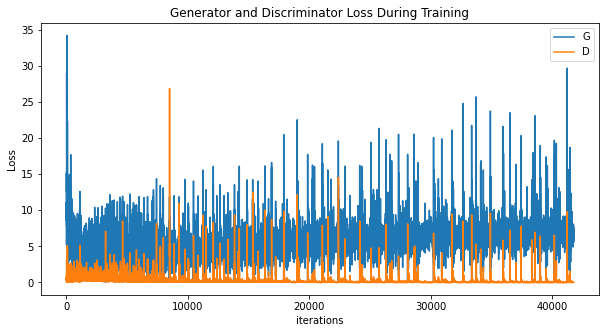

In [18]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21172992 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


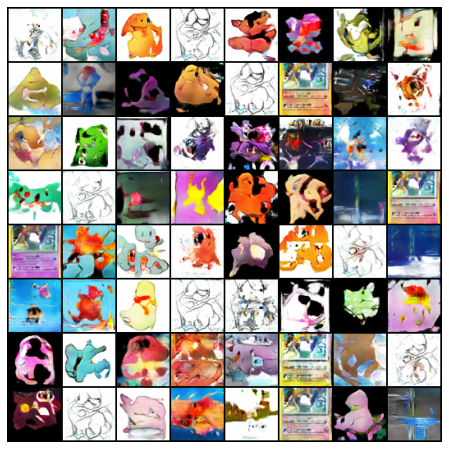

In [19]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

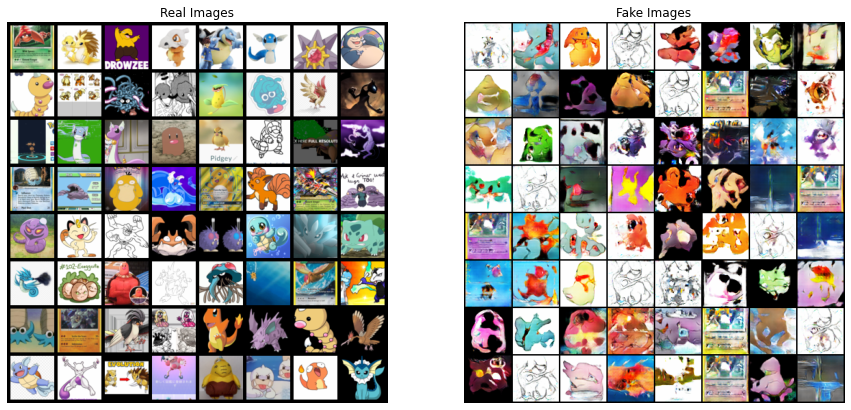

In [20]:
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

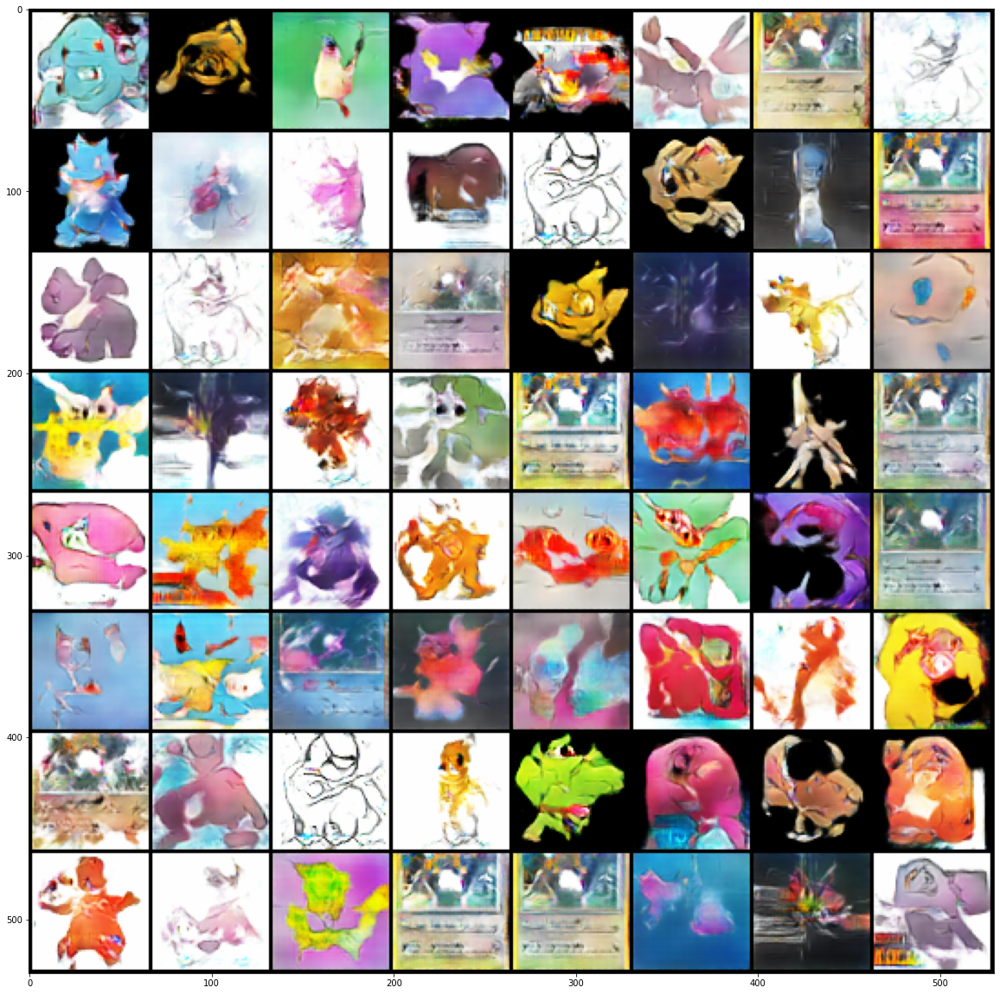

In [40]:
a= torch.randn(64, nz, 1, 1, device=device)
fake = generator(a).detach().cpu()
# plt.imshow(np.transpose(fake))

plt.figure(figsize=(20,30))
i = vutils.make_grid(fake, padding=2, normalize=True)
plt.imshow(np.transpose(i,(1,2,0)))